<a href="https://colab.research.google.com/github/Andre-do-Amaral/Competicao_Regressao/blob/main/7COMPETICAO_2_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Treino e Comparação de Modelos

In [ ]:
from sklearn.model_selection import cross_val_predict
def retorna_resultados(X = treino.drop('remuneracao_log', axis = 1), y = treino.remuneracao_log, modelo = RandomForestRegressor(),
                       num = num_11, cat = cat_11, scaler = StandardScaler(), encoder = ce.OneHotEncoder()):

  num_pipe = Pipeline(steps = [('scaler', scaler)])
  cat_pipe = Pipeline(steps = [('encoder', encoder)])
  preprocessing = ColumnTransformer([('trans_num', num_pipe, num),
                                     ('trans_cat', cat_pipe, cat)])
  pipe_ = Pipeline(steps = [('Preprocessing', preprocessing), ('model', modelo)])
  scoring = ['neg_mean_absolute_error', 'neg_root_mean_squared_error', 'r2']
  scores = cross_validate(pipe_, X, y, scoring=scoring, return_train_score = True, cv = 5)
  preditos_log = cross_val_predict(pipe_, X, y, cv = 5)
  preditos = np.exp(preditos_log)

  mae_train = scores['train_neg_mean_absolute_error']
  mae_test = scores['test_neg_mean_absolute_error']
  rmse_train = scores['train_neg_root_mean_squared_error']
  rmse_test = scores['test_neg_root_mean_squared_error']
  r2_train = scores['train_r2']
  r2_test = scores['test_r2']

  return mae_train, mae_test, rmse_train, rmse_test, r2_train, r2_test, preditos

In [ ]:
num_cats = [[(num_11, cat_11), (num_12, cat_12)],
           [(num_21, cat_21), (num_22, cat_22)],
           [(num_31, cat_31), (num_32, cat_32)],
           [(num_41, cat_41), (num_42, cat_42)],
           [(num_51, cat_51), (num_52, cat_52)],
           [(num_61, cat_61), (num_62, cat_62)]]

In [ ]:
dados.tamanho_da_empresa.unique()

array([10,  3,  7,  8,  5,  4,  6,  2,  9])

In [ ]:


dadosao = [dados_1, dados_2, dados_3,
           dados_4, dados_5, dados_6]

num_cats = [[(num_11, cat_11), (num_12, cat_12)],
           [(num_21, cat_21), (num_22, cat_22)],
           [(num_31, cat_31), (num_32, cat_32)],
           [(num_41, cat_41), (num_42, cat_42)],
           [(num_51, cat_51), (num_52, cat_52)],
           [(num_61, cat_61), (num_62, cat_62)]]
num_cats[0]
modelos = [RandomForestRegressor(), GradientBoostingRegressor(), KNeighborsRegressor(),
           Ridge(), Lasso(), ElasticNet(), SVR(), LGBMRegressor(), XGBRegressor()]

name_modelos = ['RF', 'GBR', 'KNN', 'L2', 'L1', 'L1_L2', 'SVM', 'LGBM', 'XGB']

scalers = [StandardScaler(), MinMaxScaler()]
encoders = [ce.OneHotEncoder(), ce.OrdinalEncoder(), ce.CatBoostEncoder()]
name_dados = [1,2,3,4,5,6]
name_scal = ['Standard', 'MinMax']
name_encoder = ['OneHot', 'Ordinal', 'CatBoost']
num_cats_name = [1,2]

data_frame = []
mae_train_list = []
mae_test_list = []
rmse_train_list = []
rmse_test_list = []
r2_train_list = []
r2_test_list = []
tipo = []
mae_medio_train = []
mae_median_train = []
mae_std_train = []
rmse_medio_train = []
rmse_std_train = []
r2_medio_train = []
r2_std_train = []
mae_medio_test = []
mae_median_test = []
mae_std_test = []
rmse_medio_test = []
rmse_std_test = []
r2_medio_test = []
r2_std_test = []
preditos_test = []
real_test =  np.exp(treino.remuneracao_log)
columns = ['MAE_TRAIN_MEAN', 'MAE_TEST_MEAN',
                     'MAE_TRAIN_SUM','MAE_TEST_SUM',
                     'MAE_TRAIN_STD', 'MAE_TEST_STD',
                     'RMSE_TRAIN_MEAN', 'RMSE_TEST_MEAN',
                     'RMSE_TRAIN_STD', 'RMSE_TEST_STD',
                     'R2_TRAIN_MEAN', 'R2_TEST_MEAN',
                     'R2_TRAIN_STD', 'R2_TEST_STD']
                     
for pos_dados, dados_aqui in enumerate(dadosao):
  for pos_cat, num_cat in enumerate(num_cats[pos_dados]):
    for pos_scaler, scaler in enumerate(scalers):
      for pos_encoder, encoder in enumerate(encoders):
        for pos_modelo, modelo in enumerate(modelos):
          print(f'=================Rodando {name_modelos[pos_modelo]}=================')
          mae_train, mae_test, rmse_train, rmse_test, r2_train, r2_test, preditos = retorna_resultados(X = dados_aqui.drop('remuneracao_log', axis = 1),
                                                                                             y = dados_aqui.remuneracao_log,
                                                                                             modelo = modelo,
                                                                                             num = num_cat[0],
                                                                                             cat = num_cat[1],
                                                                                             scaler = scaler, encoder = encoder)
          
          mae_train_list.append(mae_train)
          mae_test_list.append(mae_test)
          rmse_train_list.append(rmse_train)
          rmse_test_list.append(rmse_test)
          r2_train_list.append(r2_train)
          r2_test_list.append(r2_test)
          preditos_test.append(preditos)
          tipo.append(f'''Dados: {name_dados[pos_dados]}
                      Categorias: {num_cats_name[pos_cat]}
                      Scaler: {name_scal[pos_scaler]}
                      Encoder: {name_encoder[pos_encoder]}
                      Modelo: {name_modelos[pos_modelo]}''')
          
          mae_medio_train.append(mae_train.mean())
          mae_median_train.append(mae_train.sum())
          mae_std_train.append(mae_train.std())
          mae_medio_test.append(mae_test.mean())
          mae_median_test.append(mae_test.sum())
          mae_std_test.append(mae_test.std())
          rmse_medio_train.append(rmse_train.mean())
          rmse_std_train.append(rmse_train.std())
          rmse_medio_test.append(rmse_test.mean())
          rmse_std_test.append(rmse_test.std())
          r2_medio_train.append(r2_train.mean())
          r2_std_train.append(r2_train.std())
          r2_medio_test.append(r2_test.mean())
          r2_std_test.append(r2_test.std())

          data_frame.append([mae_train.mean(), mae_test.mean(),
                             mae_train.sum(), mae_test.sum(),
                             mae_train.std(), mae_test.std(),
                             rmse_train.mean(), rmse_test.mean(),
                             rmse_train.std(), rmse_test.std(),
                             r2_train.mean(), r2_test.mean(),
                             r2_train.std(), r2_test.std()])
          
          print(f'=================Rodou o {name_modelos[pos_modelo]}=================')
          
          

=================Rodando RF=================
=================Rodou o RF=================
=================Rodando GBR=================
=================Rodou o GBR=================
=================Rodando KNN=================
=================Rodou o KNN=================
=================Rodando L2=================
=================Rodou o L2=================
=================Rodando L1=================
=================Rodou o L1=================
=================Rodando L1_L2=================
=================Rodou o L1_L2=================
=================Rodando SVM=================
=================Rodou o SVM=================
=================Rodando LGBM=================
=================Rodou o LGBM=================
=================Rodando XGB=================
[16:37:47] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[16:37:48] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now depre

In [ ]:
pd.set_option('display.max_rows', None)
df = pd.DataFrame(data_frame, index = tipo, columns = columns).sort_values('MAE_TEST_MEAN', ascending = False)
df

,MAE_TRAIN_MEAN,MAE_TEST_MEAN,MAE_TRAIN_SUM,MAE_TEST_SUM,MAE_TRAIN_STD,MAE_TEST_STD,RMSE_TRAIN_MEAN,RMSE_TEST_MEAN,RMSE_TRAIN_STD,RMSE_TEST_STD,R2_TRAIN_MEAN,R2_TEST_MEAN,R2_TRAIN_STD,R2_TEST_STD
Dados: 6\n Categorias: 2\n Scaler: MinMax\n Encoder: OneHot\n Modelo: LGBM,-0.314419,-0.357050,-1.572094,-1.785252,0.001142,0.003006,-0.424053,-0.488336,0.001170,0.005934,0.661132,0.549673,0.004300,0.019788
Dados: 6\n Categorias: 2\n Scaler: MinMax\n Encoder: CatBoost\n Modelo: LGBM,-0.314419,-0.357050,-1.572094,-1.785252,0.001142,0.003006,-0.424053,-0.488336,0.001170,0.005934,0.661132,0.549673,0.004300,0.019788
Dados: 6\n Categorias: 1\n Scaler: MinMax\n Encoder: Ordinal\n Modelo: LGBM,-0.314419,-0.357050,-1.572094,-1.785252,0.001142,0.003006,-0.424053,-0.488336,0.001170,0.005934,0.661132,0.549673,0.004300,0.019788
Dados: 6\n Categorias: 2\n Scaler: MinMax\n Encoder: Ordinal\n Modelo: LGBM,-0.314419,-0.357050,-1.572094,-1.785252,0.001142,0.003006,-0.424053,-0.488336,0.001170,0.005934,0.661132,0.549673,0.004300,0.019788
Dados: 6\n Categorias: 1\n Scaler: MinMax\n Encoder: CatBoost\n Modelo: LGBM,-0.314419,-0.357050,-1.572094,-1.785252,0.001142,0.003006,-0.424053,-0.488336,0.001170,0.005934,0.661132,0.549673,0.004300,0.019788
Dados: 6\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: LGBM,-0.314419,-0.357050,-1.572094,-1.785252,0.001142,0.003006,-0.424053,-0.488336,0.001170,0.005934,0.661132,0.549673,0.004300,0.019788
Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: CatBoost\n Modelo: LGBM,-0.314420,-0.357283,-1.572100,-1.786413,0.001193,0.002282,-0.423976,-0.488299,0.001199,0.004784,0.661256,0.549737,0.004218,0.019310
Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: Ordinal\n Modelo: LGBM,-0.314420,-0.357283,-1.572100,-1.786413,0.001193,0.002282,-0.423976,-0.488299,0.001199,0.004784,0.661256,0.549737,0.004218,0.019310
Dados: 1\n Categorias: 2\n Scaler: MinMax\n Encoder: CatBoost\n Modelo: LGBM,-0.314420,-0.357283,-1.572100,-1.786413,0.001193,0.002282,-0.423976,-0.488299,0.001199,0.004784,0.661256,0.549737,0.004218,0.019310
Dados: 1\n Categorias: 2\n Scaler: MinMax\n Encoder: OneHot\n Modelo: LGBM,-0.314420,-0.357283,-1.572100,-1.786413,0.001193,0.002282,-0.423976,-0.488299,0.001199,0.004784,0.661256,0.549737,0.004218,0.019310


In [ ]:
real_test

11797     1526.86
5899      1525.97
9513     17515.11
1572      3534.93
12995     2965.29
879       2426.42
1578      2671.56
6472      1532.53
1509      2484.89
1896      6890.13
8963      5160.60
4112      1141.67
10140     1785.79
1845      1029.44
13942     2852.54
9751      3514.28
9282      1807.60
7565      1638.09
5194      3539.73
5418      5230.12
13896     1128.83
13133     1099.89
7413      1658.24
14115     2226.70
5405      9361.48
8310       502.61
3614      2719.24
2108      3507.13
12437     2371.44
8248      3533.61
14947     2096.82
11376     3025.31
14126     1204.78
7759      1040.16
12695     1342.33
5653      1350.82
13210     1218.26
8431      3286.09
6827      2003.14
14744     1117.70
4325      1303.45
3219     11135.15
9642      2413.59
6345      1145.06
6884      1100.49
1193      1174.39
45        3245.56
13954     3252.37
976       6929.87
11890     1168.82
2963     10027.52
1584      1745.21
9459      1041.14
4515       706.44
12799     1030.45
11038     

In [ ]:
pd.set_option('display.max_rows', 10)

df = pd.DataFrame(preditos_test).T
df = df.set_index(real_test.index)
df.columns = tipo
df = pd.concat([df, pd.Series(real_test, name = 'VERDADEIRO')], axis = 1)

In [ ]:
pd.set_option('display.max_rows', 10)
df

,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: OneHot\n Modelo: RF,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: OneHot\n Modelo: GBR,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: OneHot\n Modelo: KNN,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: OneHot\n Modelo: L2,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: OneHot\n Modelo: L1,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: OneHot\n Modelo: L1_L2,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: OneHot\n Modelo: SVM,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: OneHot\n Modelo: LGBM,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: OneHot\n Modelo: XGB,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: Ordinal\n Modelo: RF,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: Ordinal\n Modelo: GBR,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: Ordinal\n Modelo: KNN,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: Ordinal\n Modelo: L2,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: Ordinal\n Modelo: L1,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: Ordinal\n Modelo: L1_L2,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: Ordinal\n Modelo: SVM,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: Ordinal\n Modelo: LGBM,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: Ordinal\n Modelo: XGB,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: RF,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: GBR,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: KNN,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L2,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L1,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L1_L2,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: SVM,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: LGBM,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: XGB,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: RF,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: GBR,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: KNN,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: L2,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: L1,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: L1_L2,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: SVM,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: LGBM,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: XGB,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: Ordinal\n Modelo: RF,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: Ordinal\n Modelo: GBR,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: Ordinal\n Modelo: KNN,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: Ordinal\n Modelo: L2,...,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: Ordinal\n Modelo: SVM,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: Ordinal\n Modelo: LGBM,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: Ordinal\n Modelo: XGB,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: RF,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: GBR,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: KNN,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L2,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L1,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L1_L2,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: SVM,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: LGBM,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: XGB,Dados: 6\n Categor

In [ ]:
erros = df.copy()
for column in erros.columns:
  erros[column] = erros[column] - erros['VERDADEIRO']
erros

,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: OneHot\n Modelo: RF,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: OneHot\n Modelo: GBR,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: OneHot\n Modelo: KNN,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: OneHot\n Modelo: L2,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: OneHot\n Modelo: L1,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: OneHot\n Modelo: L1_L2,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: OneHot\n Modelo: SVM,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: OneHot\n Modelo: LGBM,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: OneHot\n Modelo: XGB,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: Ordinal\n Modelo: RF,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: Ordinal\n Modelo: GBR,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: Ordinal\n Modelo: KNN,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: Ordinal\n Modelo: L2,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: Ordinal\n Modelo: L1,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: Ordinal\n Modelo: L1_L2,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: Ordinal\n Modelo: SVM,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: Ordinal\n Modelo: LGBM,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: Ordinal\n Modelo: XGB,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: RF,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: GBR,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: KNN,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L2,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L1,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L1_L2,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: SVM,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: LGBM,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: XGB,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: RF,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: GBR,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: KNN,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: L2,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: L1,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: L1_L2,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: SVM,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: LGBM,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: XGB,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: Ordinal\n Modelo: RF,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: Ordinal\n Modelo: GBR,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: Ordinal\n Modelo: KNN,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: Ordinal\n Modelo: L2,...,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: Ordinal\n Modelo: SVM,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: Ordinal\n Modelo: LGBM,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: Ordinal\n Modelo: XGB,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: RF,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: GBR,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: KNN,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L2,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L1,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L1_L2,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: SVM,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: LGBM,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: XGB,Dados: 6\n Categor

In [ ]:
t = erros.filter(regex = '(Dados: 6|Dados: 1)').filter(regex = 'CatB').filter(regex = 'Standard').filter(regex = 'Categorias: 1\n')
metricas = t.T.describe()
metricas

,11797,5899,9513,1572,12995,879,1578,6472,1509,1896,8963,4112,10140,1845,13942,9751,9282,7565,5194,5418,13896,13133,7413,14115,5405,8310,3614,2108,12437,8248,14947,11376,14126,7759,12695,5653,13210,8431,6827,14744,...,2747,2047,7849,2558,9274,8666,11096,13035,6396,12309,3385,4555,1184,6420,5051,5311,2433,6949,13803,10583,769,1685,8322,11111,11363,11636,14423,5578,4426,13526,466,6265,5734,11284,11964,5191,13418,5390,860,7270
count,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,...,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000
mean,176.498310,155.426938,-13739.713992,-1797.062124,-714.741070,-459.948334,2175.909302,409.594770,-771.889249,-3669.475323,-3094.308143,331.532719,-275.195350,662.801946,-921.755087,-651.686246,-213.529170,264.301206,-803.810672,-1995.748263,288.199819,320.422024,-110.134399,-258.332253,-6234.110157,596.235603,14.011719,-1430.079935,-659.667334,-1763.808703,410.725614,-528.166586,162.202367,692.927891,111.915720,14.618259,517.173908,408.561259,-534.190428,142.814538,...,2193.677237,262.711120,352.434733,333.434271,22.780061,-776.760826,-378.669605,244.440058,1085.703875,749.013137,199.227844,379.271427,672.558853,1370.842995,-2670.069531,-1523.918613,-2062.809259,619.027979,413.637572,-6823.579333,589.531344,353.831392,-499.975785,432.080906,1154.961592,-838.437039,-437.855370,229.737505,-1330.553086,-1098.360433,1244.239512,-11396.563934,2147.978142,-3015.213680,370.183907,301.921390,1454.740169,559.092326,753.972868,369.560172
std,155.895838,151.870290,628.762497,106.356813,646.350188,372.004262,957.614889,751.270580,157.750763,1032.651560,303.396434,217.990753,181.200175,85.816794,172.412605,442.649661,147.580593,733.109438,492.521317,1006.606202,183.723659,202.195418,173.218433,701.602019,1052.947141,394.544963,371.477920,667.069826,200.791651,88.261316,539.038792,597.606814,237.485453,851.911112,200.165218,257.472679,291.029628,1522.336790,191.322713,355.132250,...,1184.611206,478.669733,1163.529764,242.737413,299.514075,653.592360,124.333547,181.288430,465.477754,172.066232,511.140323,210.104224,535.965395,706.012930,380.878264,168.038046,664.839249,172.145289,523.375124,1553.448452,281.004190,261.983331,528.616767,122.392337,362.746480,364.318686,200.826174,377.734990,278.029678,627.620602,586.290443,729.019856,497.785552,1853.262886,138.786155,230.322066,681.494742,164.251886,127.353771,223.399559
min,-94.576284,-14.431804,-14459.343171,-1991.052170,-1412.572123,-866.547216,524.788883,-481.950571,-1247.183490,-5122.004380,-3616.072315,-21.134673,-671.091927,492.068819,-1136.904457,-1758.232885,-373.223626,-247.839921,-1755.229487,-3508.654957,62.412589,134.855660,-414.178938,-869.310437,-7593.354380,-15.974679,-409.810706,-2135.542460,-992.181097,-1878.955265,-328.694380,-1503.429271,-86.991378,-194.582112,-126.076475,-401.809403,206.013339,-1517.964380,-843.290472,-493.105811,...,489.068447,-267.487470,-1142.119663,109.123422,-249.549818,-1751.756889,-506.692283,89.667237,337.385652,558.774014,-315.016803,163.106196,94.306323,378.918781,-3137.968097,-1797.141256,-3143.571553,268.100521,-21.918090,-8932.921553,149.661124,49.511924,-1522.711416,298.619123,418.775026,-1506.068014,-649.747992,-533.467460,-1714.411276,-1636.663009,212.119046,-12446.791553,1312.704235,-5352.131276,215.689461,108.551789,208.

In [ ]:

pd.set_option('max_rows', 10)
aux_filt = t.T.abs()
aux_filt

,11797,5899,9513,1572,12995,879,1578,6472,1509,1896,8963,4112,10140,1845,13942,9751,9282,7565,5194,5418,13896,13133,7413,14115,5405,8310,3614,2108,12437,8248,14947,11376,14126,7759,12695,5653,13210,8431,6827,14744,...,2747,2047,7849,2558,9274,8666,11096,13035,6396,12309,3385,4555,1184,6420,5051,5311,2433,6949,13803,10583,769,1685,8322,11111,11363,11636,14423,5578,4426,13526,466,6265,5734,11284,11964,5191,13418,5390,860,7270
Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: RF,335.123819,522.003935,13105.257187,1672.097689,1412.572123,342.793371,2898.602210,151.864520,698.679199,3340.987782,3039.438038,18.722113,316.173134,597.337871,1082.960081,445.148715,31.245189,236.693685,1227.752447,1188.038284,301.320772,210.962625,283.232355,399.253110,6227.468662,345.544370,282.335005,1716.209653,787.955817,1834.635333,1286.405217,1317.283439,61.276785,272.847695,79.266172,168.901758,214.619244,2713.202248,810.480342,270.882605,...,3110.436776,211.795471,2393.608523,225.035245,17.243395,1586.587650,501.219455,91.974705,730.641800,1249.005197,315.016803,494.269134,114.152766,444.179731,2040.818133,1391.331855,1849.112042,944.258998,21.918090,4849.180664,149.661124,697.292910,1189.595683,298.619123,1982.898406,894.636629,472.646391,343.790648,1502.799071,1439.065047,293.592413,10661.828750,1533.065092,556.726278,371.177165,456.997341,2443.158224,702.691487,628.772372,346.768363
Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: GBR,129.931092,29.966077,13621.685592,1814.041210,1221.439952,647.178869,2433.206421,351.618890,737.469313,2859.029187,3036.377921,284.711750,364.619812,675.109923,899.302626,828.381015,331.672550,96.043527,475.161030,1828.871751,140.889585,270.122614,227.319220,652.983634,5106.824312,433.733606,303.114505,1919.707857,748.537744,1798.932614,706.429085,793.949267,8.002573,512.857264,35.163204,43.653204,407.829480,1361.998866,661.511404,113.175870,...,2826.632372,107.339942,349.845613,235.875434,84.021792,868.746072,426.655622,169.070900,875.295467,629.442946,96.989535,163.106196,147.216889,1041.018716,2643.544573,1571.639527,1539.589212,561.407219,23.371791,5725.799575,344.610786,213.092972,140.467013,348.280010,815.057786,868.336294,560.439803,243.052097,1258.113161,1539.946787,1258.141130,10750.693962,2422.888771,2604.262809,275.640599,159.396846,2069.437617,562.984295,705.540466,291.442128
Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: KNN,260.904917,99.609522,14459.343171,1885.125066,779.420747,866.547216,3379.880099,344.659256,1045.022034,4260.278105,3616.072315,52.640381,580.312098,548.343999,652.254011,1758.232885,237.948972,247.839921,1755.229487,1546.150961,62.412589,256.154357,49.520984,538.904156,4773.874687,15.974679,409.810706,1254.227350,992.181097,1878.955265,61.198924,643.211848,86.991378,464.459623,129.205618,401.809403,1545.670162,621.370517,385.104691,49.382230,...,4216.627090,440.323063,1680.244178,109.123422,165.358098,1751.756889,429.683304,92.924618,337.385652,667.036377,71.887155,282.693195,1117.457762,496.476434,3137.968097,1473.597805,2573.795180,268.100521,21.446564,6677.172748,750.636710,977.931278,1522.711416,390.421248,864.541015,448.133650,468.295162,537.898809,1292.769578,1636.663009,754.514576,11204.677762,1933.711954,1092.748341,231.292168,188.530316,662.313076,709.035617,1039.396186,316.847053
Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L2,450.241268,244.671327,13957.564446,1920.741333,960.055859,235.610915,2906.826158,6.018715,659.466673,3407.645613,2517.263327,443.672084,129.975679,713.909438,602.546952,94.855707,179.926668,81.539980,328.016662,1921.741216,218.211283,138.954651,49.919679,439.360452,6640.551256,464.605016,359.363682,1758.248571,507.043185,1559.505816,713.247636,144.720726,171.089286,36.810772,154.669699,32.053635,563.741032,61.520578,478.938425,493.105811,...,1579.855325,296.935487,1138.970984,268.515749,246.725589,358.381350,79.761629,298.733234,1632.909626,87

### Selecionando meus maiores erros

In [ ]:
soma_aux = pd.DataFrame(pd.Series(aux_filt.sum(), name = 'soma'))
index_outliers = soma_aux[soma_aux['soma']>20000].index
index_normais = soma_aux[soma_aux['soma']<=20000].index

In [ ]:
print(len(index_normais))
print(len(index_outliers))
display(aux_filt[index_normais].head(1))
display(aux_filt[index_outliers].head(1))
display(t.T.head())

7423
3077


,11797,5899,12995,879,6472,1509,4112,10140,1845,13942,9751,9282,7565,5194,13896,13133,7413,14115,8310,3614,12437,14947,11376,14126,7759,12695,5653,13210,6827,14744,4325,9642,6345,6884,1193,11890,1584,9459,4515,12799,...,10253,8792,5393,14502,11080,8838,3890,3556,11394,1528,7734,1899,189,2047,7849,2558,9274,8666,11096,13035,6396,12309,3385,4555,1184,6949,13803,769,1685,8322,11111,11636,14423,5578,13526,11964,5191,5390,860,7270
Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: RF,335.123819,522.003935,1412.572123,342.793371,151.86452,698.679199,18.722113,316.173134,597.337871,1082.960081,445.148715,31.245189,236.693685,1227.752447,301.320772,210.962625,283.232355,399.25311,345.54437,282.335005,787.955817,1286.405217,1317.283439,61.276785,272.847695,79.266172,168.901758,214.619244,810.480342,270.882605,857.57816,154.789493,733.72387,139.007442,387.012867,144.088952,0.603608,1118.750739,1130.778901,104.31113,...,265.541359,300.220329,686.608999,191.625248,709.735156,285.346172,6.360838,249.293961,1406.96325,1739.528719,99.823818,68.819622,105.439057,211.795471,2393.608523,225.035245,17.243395,1586.58765,501.219455,91.974705,730.6418,1249.005197,315.016803,494.269134,114.152766,944.258998,21.91809,149.661124,697.29291,1189.595683,298.619123,894.636629,472.646391,343.790648,1439.065047,371.177165,456.997341,702.691487,628.772372,346.768363


,9513,1572,1578,1896,8963,5418,5405,2108,8248,8431,3219,45,13954,976,2963,3912,9811,11880,12456,11923,12450,10132,37,576,4822,2335,11522,1180,13142,13204,9558,5733,9185,2829,10735,5277,8254,4219,11705,3118,...,8571,14552,12185,7892,7869,9467,11990,14605,161,5675,14737,7989,13417,1021,3152,8226,9555,7513,10555,10627,14356,1267,4658,3005,2734,9998,9167,2747,6420,5051,5311,2433,10583,11363,4426,466,6265,5734,11284,13418
Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: RF,13105.257187,1672.097689,2898.60221,3340.987782,3039.438038,1188.038284,6227.468662,1716.209653,1834.635333,2713.202248,5094.573561,1244.733626,1489.47397,332.115267,4932.133044,7196.236531,1088.723423,4798.118959,1143.059309,1837.570418,2538.845513,3814.544842,6278.835455,1728.210775,3701.819532,2588.320905,1269.914655,2168.518119,2204.801744,1061.468062,1186.863615,10139.662347,4572.147177,1210.513713,1114.426282,4739.987563,2189.577878,2541.645699,6422.811735,7787.816074,...,1835.928376,6926.629467,1728.499312,1973.72325,2884.354625,1782.434052,3426.63164,56.1022,1258.46089,1776.37134,12398.887425,1303.621834,1201.471483,1159.362678,21061.630171,2547.315336,2039.404941,7595.883784,2230.014785,6990.944993,1408.386564,581.022694,302.568625,923.622562,1258.821471,2416.824437,5578.99648,3110.436776,444.179731,2040.818133,1391.331855,1849.112042,4849.180664,1982.898406,1502.799071,293.592413,10661.82875,1533.065092,556.726278,2443.158224


,11797,5899,9513,1572,12995,879,1578,6472,1509,1896,8963,4112,10140,1845,13942,9751,9282,7565,5194,5418,13896,13133,7413,14115,5405,8310,3614,2108,12437,8248,14947,11376,14126,7759,12695,5653,13210,8431,6827,14744,...,2747,2047,7849,2558,9274,8666,11096,13035,6396,12309,3385,4555,1184,6420,5051,5311,2433,6949,13803,10583,769,1685,8322,11111,11363,11636,14423,5578,4426,13526,466,6265,5734,11284,11964,5191,13418,5390,860,7270
Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: RF,335.123819,522.003935,-13105.257187,-1672.097689,-1412.572123,342.793371,2898.602210,-151.864520,-698.679199,-3340.987782,-3039.438038,-18.722113,-316.173134,597.337871,-1082.960081,-445.148715,31.245189,-236.693685,-1227.752447,-1188.038284,301.320772,210.962625,-283.232355,-399.253110,-6227.468662,345.544370,-282.335005,-1716.209653,-787.955817,-1834.635333,1286.405217,-1317.283439,61.276785,272.847695,-79.266172,-168.901758,214.619244,2713.202248,-810.480342,270.882605,...,3110.436776,-211.795471,2393.608523,225.035245,-17.243395,-1586.587650,-501.219455,91.974705,730.641800,1249.005197,-315.016803,494.269134,114.152766,444.179731,-2040.818133,-1391.331855,-1849.112042,944.258998,-21.918090,-4849.180664,149.661124,697.292910,-1189.595683,298.619123,1982.898406,-894.636629,-472.646391,343.790648,-1502.799071,-1439.065047,293.592413,-10661.828750,1533.065092,556.726278,371.177165,456.997341,2443.158224,702.691487,628.772372,346.768363
Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: GBR,129.931092,29.966077,-13621.685592,-1814.041210,-1221.439952,-647.178869,2433.206421,351.618890,-737.469313,-2859.029187,-3036.377921,284.711750,-364.619812,675.109923,-899.302626,-828.381015,-331.672550,-96.043527,-475.161030,-1828.871751,140.889585,270.122614,-227.319220,-652.983634,-5106.824312,433.733606,-303.114505,-1919.707857,-748.537744,-1798.932614,706.429085,-793.949267,8.002573,512.857264,-35.163204,-43.653204,407.829480,1361.998866,-661.511404,113.175870,...,2826.632372,-107.339942,349.845613,235.875434,-84.021792,-868.746072,-426.655622,169.070900,875.295467,629.442946,-96.989535,163.106196,147.216889,1041.018716,-2643.544573,-1571.639527,-1539.589212,561.407219,23.371791,-5725.799575,344.610786,213.092972,-140.467013,348.280010,815.057786,-868.336294,-560.439803,243.052097,-1258.113161,-1539.946787,1258.141130,-10750.693962,2422.888771,-2604.262809,275.640599,159.396846,2069.437617,562.984295,705.540466,291.442128
Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: KNN,260.904917,99.609522,-14459.343171,-1885.125066,-779.420747,-866.547216,3379.880099,344.659256,-1045.022034,-4260.278105,-3616.072315,52.640381,-580.312098,548.343999,-652.254011,-1758.232885,-237.948972,-247.839921,-1755.229487,-1546.150961,62.412589,256.154357,49.520984,-538.904156,-4773.874687,-15.974679,-409.810706,-1254.227350,-992.181097,-1878.955265,61.198924,-643.211848,-86.991378,464.459623,129.205618,-401.809403,1545.670162,621.370517,-385.104691,49.382230,...,4216.627090,440.323063,1680.244178,109.123422,-165.358098,-1751.756889,-429.683304,92.924618,337.385652,667.036377,71.887155,282.693195,1117.457762,496.476434,-3137.968097,-1473.597805,-2573.795180,268.100521,-21.446564,-6677.172748,750.636710,977.931278,-1522.711416,390.421248,864.541015,-448.133650,-468.295162,537.898809,-1292.769578,-1636.663009,754.514576,-11204.677762,1933.711954,-1092.748341,231.292168,188.530316,662.313076,709.035617,1039.396186,316.847053
Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L2,450.241268,244.671327,-13957.564446,-1920.741333,-960.055859,-235.610915,2906.826158,-6.018715,-659.466673,-3407.645613,-2517.263327,443.672084,-129.975679,713.909438,-602.546952,-94.855707,-179.926668,81.539980,-328.016662,-1921.741216,218.211283,138.954651,-49.919679,-439.360452,-6640.551256,464.605016,359.363682,-1758.248571,-507.043185,-1559.505816,713.247636,144.720726,171.089286,-36.810772,154.669699,32.053635,563.741

In [ ]:
t_transpose = t.T.copy() #previsto - verdadeiro
fig = px.histogram(t_transpose[index_outliers])
fig.show()

/usr/local/lib/python3.7/dist-packages/plotly/express/_core.py:1222: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  df_output[col_name] = to_unindexed_series(df_input[argument])


In [ ]:
t_transpose = t.T.copy() #previsto - verdadeiro
fig = px.histogram(t_transpose[index_normais])
fig.show()

/usr/local/lib/python3.7/dist-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`



In [ ]:
#aux = metricas.T
#aux[(aux['50%']>1000)|(aux['50%']<-1000)].abs().mean()

In [ ]:
#aux[(aux['50%']<5000)&(aux['50%']>-5000)].abs()#.mean()

In [ ]:


#index_normais = aux[(aux['50%']<2000)&(aux['50%']>-2000)].abs().index
#index_outliers = aux[(aux['50%']>2000)|(aux['50%']<-2000)].abs().index

In [ ]:


normais = dados.loc[index_normais]
out = dados.loc[index_outliers]


### Entendendo o que torna um dado com erros grandes e com erros normais

================sexo=============


,sexo,sexo
1,4329,0.583187
2,3094,0.416813


Grafico de distribuição de idade com relação a sexo


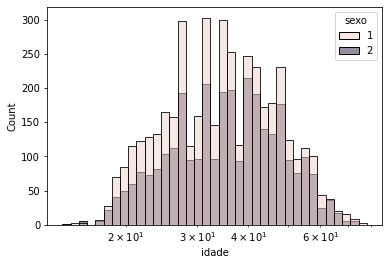

==================Categoria 1


count    4329.000000
mean       35.890044
std        11.113509
min        14.000000
25%        27.000000
50%        34.000000
75%        43.000000
max        78.000000
Name: idade, dtype: float64

==================Categoria 2


count    3094.000000
mean       36.774402
std        10.981902
min        14.000000
25%        28.000000
50%        36.000000
75%        44.000000
max        74.000000
Name: idade, dtype: float64

Grafico de distribuição de horas_trabalho_por_semana com relação a sexo


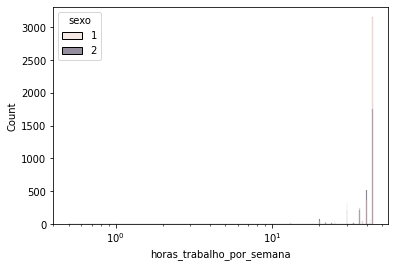

==================Categoria 1


count    4329.000000
mean       41.196466
std         6.492133
min         0.500000
25%        40.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 2


count    3094.000000
mean       39.362153
std         7.429983
min         0.500000
25%        36.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a sexo


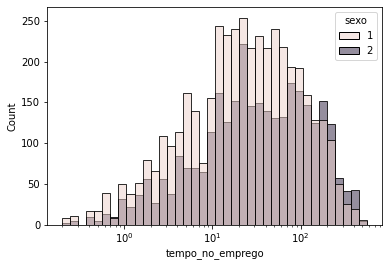

==================Categoria 1


count    4329.000000
mean       50.281959
std        66.806669
min         0.200000
25%         8.800000
50%        23.500000
75%        64.900000
max       561.600000
Name: tempo_no_emprego, dtype: float64

==================Categoria 2


count    3094.000000
mean       68.196542
std        84.626565
min         0.200000
25%        11.325000
50%        31.800000
75%        94.475000
max       525.900000
Name: tempo_no_emprego, dtype: float64

Grafico de distribuição de remuneracao com relação a sexo


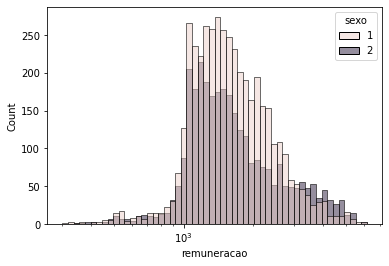

==================Categoria 1


count    4329.000000
mean     1720.355098
std       744.983663
min       301.430000
25%      1212.180000
50%      1529.930000
75%      2054.710000
max      5877.420000
Name: remuneracao, dtype: float64

==================Categoria 2


count    3094.000000
mean     1824.219250
std       948.138727
min       343.840000
25%      1182.407500
50%      1501.240000
75%      2134.010000
max      6141.800000
Name: remuneracao, dtype: float64

Grafico de distribuição de id com relação a sexo


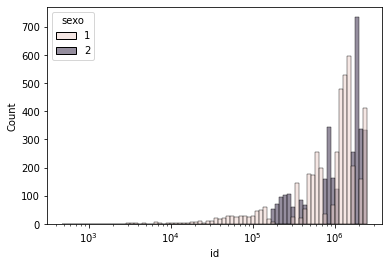

==================Categoria 1


count    4.329000e+03
mean     1.091476e+06
std      6.505612e+05
min      4.770000e+02
25%      5.524750e+05
50%      1.179030e+06
75%      1.479791e+06
max      2.350277e+06
Name: id, dtype: float64

==================Categoria 2


count    3.094000e+03
mean     1.352859e+06
std      7.416831e+05
min      1.728660e+05
25%      7.907280e+05
50%      1.718010e+06
75%      1.939978e+06
max      2.459818e+06
Name: id, dtype: float64

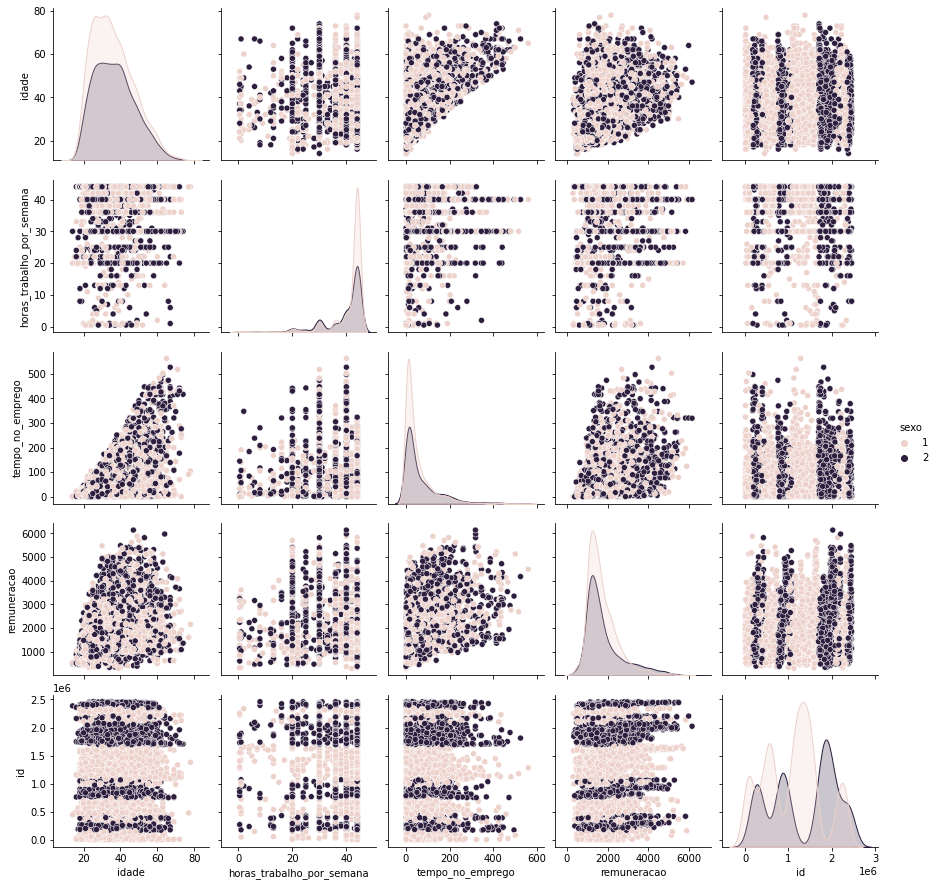

================faixa_etaria=============


,faixa_etaria,faixa_etaria
5,2393,0.322376
6,1690,0.227671
4,1241,0.167183
3,1084,0.146033
7,917,0.123535
8,73,0.009834
2,23,0.003098
1,2,0.000269


Grafico de distribuição de idade com relação a faixa_etaria


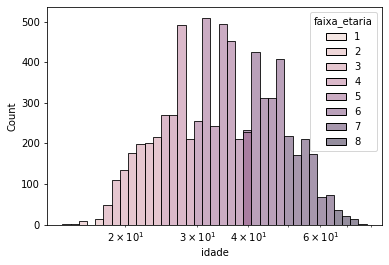

==================Categoria 6


count    1690.000000
mean       43.936095
std         2.880191
min        40.000000
25%        41.000000
50%        44.000000
75%        46.000000
max        49.000000
Name: idade, dtype: float64

==================Categoria 4


count    1241.000000
mean       26.899275
std         1.401730
min        25.000000
25%        26.000000
50%        27.000000
75%        28.000000
max        29.000000
Name: idade, dtype: float64

==================Categoria 3


count    1084.000000
mean       21.687269
std         1.782490
min        18.000000
25%        20.000000
50%        22.000000
75%        23.000000
max        24.000000
Name: idade, dtype: float64

==================Categoria 7


count    917.000000
mean      55.000000
std        3.906103
min       50.000000
25%       52.000000
50%       54.000000
75%       58.000000
max       64.000000
Name: idade, dtype: float64

==================Categoria 5


count    2393.000000
mean       34.337651
std         2.865372
min        30.000000
25%        32.000000
50%        34.000000
75%        37.000000
max        39.000000
Name: idade, dtype: float64

==================Categoria 1


count     2.0
mean     14.0
std       0.0
min      14.0
25%      14.0
50%      14.0
75%      14.0
max      14.0
Name: idade, dtype: float64

==================Categoria 8


count    73.000000
mean     68.397260
std       3.076523
min      65.000000
25%      66.000000
50%      67.000000
75%      70.000000
max      78.000000
Name: idade, dtype: float64

==================Categoria 2


count    23.000000
mean     16.478261
std       0.665348
min      15.000000
25%      16.000000
50%      17.000000
75%      17.000000
max      17.000000
Name: idade, dtype: float64

Grafico de distribuição de horas_trabalho_por_semana com relação a faixa_etaria


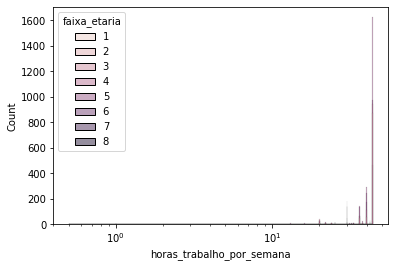

==================Categoria 6


count    1690.000000
mean       39.541420
std         7.333391
min         0.500000
25%        36.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 4


count    1241.000000
mean       41.607977
std         6.066734
min         0.500000
25%        44.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 3


count    1084.000000
mean       41.572878
std         6.605927
min         0.500000
25%        44.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 7


count    917.000000
mean      39.097601
std        7.012895
min        0.500000
25%       36.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 5


count    2393.000000
mean       40.740493
std         6.747053
min         0.500000
25%        40.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 1


count     2.000000
mean     25.000000
std       7.071068
min      20.000000
25%      22.500000
50%      25.000000
75%      27.500000
max      30.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 8


count    73.000000
mean     35.794521
std       9.419187
min       1.000000
25%      30.000000
50%      40.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 2


count    23.000000
mean     25.782609
std       9.085235
min      20.000000
25%      20.000000
50%      22.000000
75%      26.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a faixa_etaria


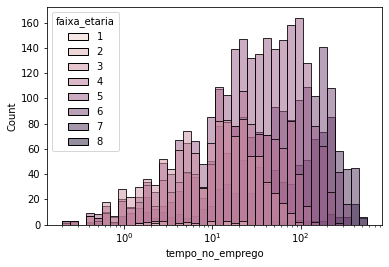

==================Categoria 6


count    1690.00000
mean       78.32645
std        76.68103
min         0.20000
25%        15.75000
50%        47.90000
75%       128.27500
max       368.90000
Name: tempo_no_emprego, dtype: float64

==================Categoria 4


count    1241.000000
mean       27.982756
std        26.949500
min         0.200000
25%         7.500000
50%        18.800000
75%        39.900000
max       133.400000
Name: tempo_no_emprego, dtype: float64

==================Categoria 3


count    1084.000000
mean       14.294742
std        14.903351
min         0.200000
25%         3.600000
50%         9.900000
75%        20.200000
max       104.600000
Name: tempo_no_emprego, dtype: float64

==================Categoria 7


count    917.000000
mean     127.377099
std      118.513134
min        0.300000
25%       25.000000
50%       94.700000
75%      199.800000
max      501.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 5


count    2393.000000
mean       46.842457
std        46.914222
min         0.200000
25%        10.900000
50%        29.300000
75%        70.900000
max       250.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 1


count    2.000000
mean     1.800000
std      0.565685
min      1.400000
25%      1.600000
50%      1.800000
75%      2.000000
max      2.200000
Name: tempo_no_emprego, dtype: float64

==================Categoria 8


count     73.000000
mean     232.608219
std      164.831885
min        0.500000
25%       78.900000
50%      227.000000
75%      386.800000
max      561.600000
Name: tempo_no_emprego, dtype: float64

==================Categoria 2


count    23.00000
mean      8.43913
std       7.02125
min       1.40000
25%       2.55000
50%       5.50000
75%      14.95000
max      21.80000
Name: tempo_no_emprego, dtype: float64

Grafico de distribuição de remuneracao com relação a faixa_etaria


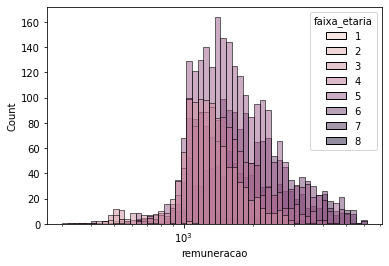

==================Categoria 6


count    1690.000000
mean     1987.888243
std       949.325155
min       327.040000
25%      1288.675000
50%      1697.395000
75%      2402.790000
max      6141.800000
Name: remuneracao, dtype: float64

==================Categoria 4


count    1241.000000
mean     1567.328147
std       593.807219
min       349.910000
25%      1157.000000
50%      1418.710000
75%      1812.630000
max      4613.610000
Name: remuneracao, dtype: float64

==================Categoria 3


count    1084.000000
mean     1317.393026
std       425.625128
min       326.150000
25%      1067.780000
50%      1251.715000
75%      1482.282500
max      3556.980000
Name: remuneracao, dtype: float64

==================Categoria 7


count     917.000000
mean     2110.424351
std      1040.671486
min       502.670000
25%      1342.240000
50%      1777.640000
75%      2586.210000
max      5974.310000
Name: remuneracao, dtype: float64

==================Categoria 5


count    2393.000000
mean     1778.433782
std       790.551760
min       301.430000
25%      1235.820000
50%      1556.470000
75%      2111.230000
max      5477.340000
Name: remuneracao, dtype: float64

==================Categoria 1


count      2.00000
mean     519.98000
std       24.56489
min      502.61000
25%      511.29500
50%      519.98000
75%      528.66500
max      537.35000
Name: remuneracao, dtype: float64

==================Categoria 8


count      73.000000
mean     2083.964932
std       907.128903
min       623.220000
25%      1434.590000
50%      1887.430000
75%      2637.730000
max      4487.360000
Name: remuneracao, dtype: float64

==================Categoria 2


count      23.000000
mean      638.765652
std       219.471771
min       466.530000
25%       504.510000
50%       523.730000
75%       747.955000
max      1144.250000
Name: remuneracao, dtype: float64

Grafico de distribuição de id com relação a faixa_etaria


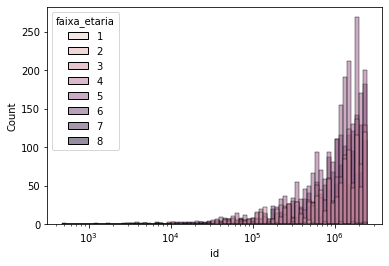

==================Categoria 6


count    1.690000e+03
mean     1.216882e+06
std      6.948159e+05
min      3.781000e+03
25%      6.278775e+05
50%      1.172716e+06
75%      1.792392e+06
max      2.458471e+06
Name: id, dtype: float64

==================Categoria 4


count    1.241000e+03
mean     1.197259e+06
std      7.121070e+05
min      3.195000e+03
25%      5.764230e+05
50%      1.238370e+06
75%      1.820907e+06
max      2.457833e+06
Name: id, dtype: float64

==================Categoria 3


count    1.084000e+03
mean     1.148086e+06
std      7.314615e+05
min      4.815000e+03
25%      5.024968e+05
50%      1.196954e+06
75%      1.774600e+06
max      2.451342e+06
Name: id, dtype: float64

==================Categoria 7


count    9.170000e+02
mean     1.237052e+06
std      7.037086e+05
min      1.187000e+03
25%      6.327760e+05
50%      1.218198e+06
75%      1.778964e+06
max      2.445626e+06
Name: id, dtype: float64

==================Categoria 5


count    2.393000e+03
mean     1.201849e+06
std      6.873675e+05
min      4.770000e+02
25%      6.003570e+05
50%      1.222348e+06
75%      1.790268e+06
max      2.459818e+06
Name: id, dtype: float64

==================Categoria 1


count    2.000000e+00
mean     1.416436e+06
std      1.369908e+06
min      4.477640e+05
25%      9.320998e+05
50%      1.416436e+06
75%      1.900771e+06
max      2.385107e+06
Name: id, dtype: float64

==================Categoria 8


count    7.300000e+01
mean     1.216210e+06
std      6.158228e+05
min      6.847000e+03
25%      9.838720e+05
50%      1.179273e+06
75%      1.708747e+06
max      2.224773e+06
Name: id, dtype: float64

==================Categoria 2


count    2.300000e+01
mean     9.510079e+05
std      7.877024e+05
min      1.371800e+04
25%      4.675165e+05
50%      7.648670e+05
75%      1.745934e+06
max      2.362464e+06
Name: id, dtype: float64

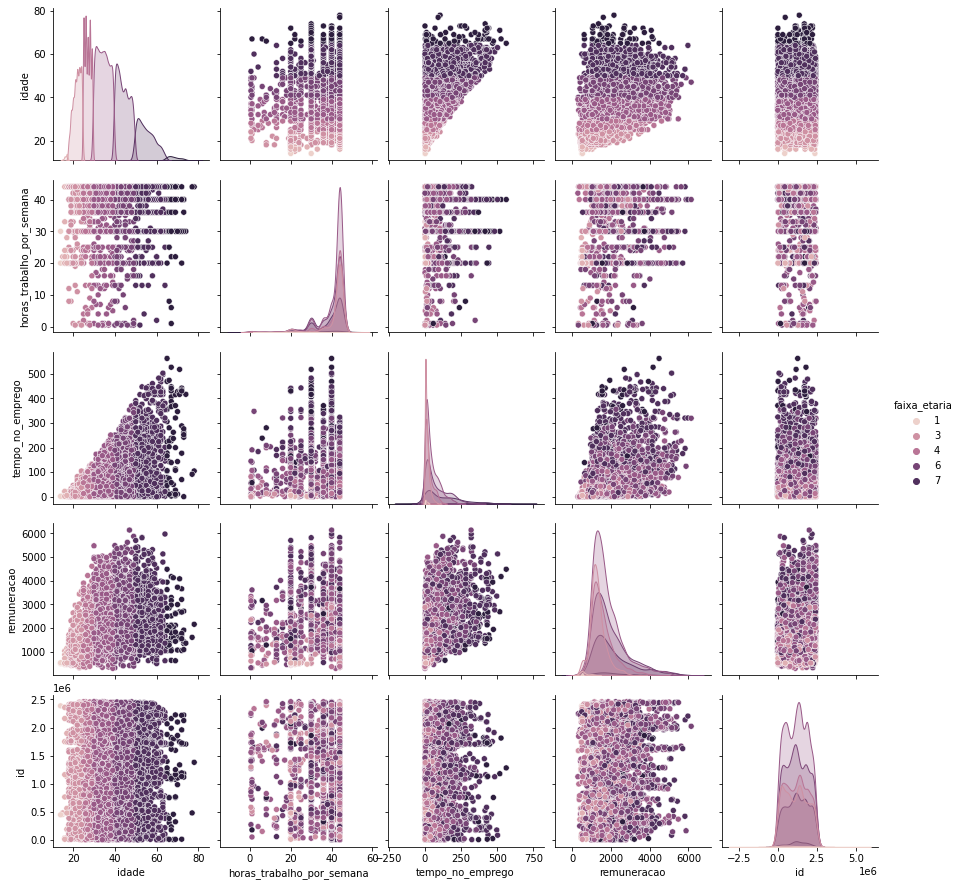

================cor_raca=============


,cor_raca,cor_raca
8,3872,0.521622
99,1569,0.211370
9,1002,0.134986
2,747,0.100633
4,180,0.024249
6,41,0.005523
1,12,0.001617


Grafico de distribuição de idade com relação a cor_raca


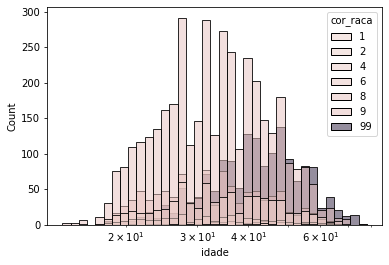

==================Categoria 8


count    3872.000000
mean       34.441890
std        10.317398
min        14.000000
25%        26.000000
50%        33.000000
75%        41.000000
max        78.000000
Name: idade, dtype: float64

==================Categoria 9


count    1002.000000
mean       33.919162
std        10.314943
min        17.000000
25%        25.000000
50%        32.000000
75%        41.000000
max        66.000000
Name: idade, dtype: float64

==================Categoria 99


count    1569.000000
mean       42.767368
std        10.968941
min        18.000000
25%        35.000000
50%        42.000000
75%        50.000000
max        74.000000
Name: idade, dtype: float64

==================Categoria 2


count    747.000000
mean      35.613119
std       10.921067
min       17.000000
25%       27.000000
50%       34.000000
75%       43.000000
max       77.000000
Name: idade, dtype: float64

==================Categoria 4


count    180.000000
mean      33.283333
std       10.550901
min       16.000000
25%       25.000000
50%       31.500000
75%       40.000000
max       67.000000
Name: idade, dtype: float64

==================Categoria 6


count    41.000000
mean     39.609756
std      10.530617
min      21.000000
25%      33.000000
50%      38.000000
75%      44.000000
max      64.000000
Name: idade, dtype: float64

==================Categoria 1


count    12.000000
mean     40.166667
std      10.187634
min      26.000000
25%      32.750000
50%      40.500000
75%      43.750000
max      59.000000
Name: idade, dtype: float64

Grafico de distribuição de horas_trabalho_por_semana com relação a cor_raca


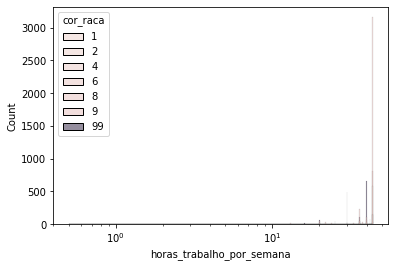

==================Categoria 8


count    3872.000000
mean       41.909478
std         6.126730
min         0.500000
25%        44.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 9


count    1002.000000
mean       42.089321
std         5.774202
min         0.500000
25%        44.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 99


count    1569.000000
mean       35.204589
std         6.908168
min         1.000000
25%        30.000000
50%        40.000000
75%        40.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 2


count    747.000000
mean      41.213521
std        7.318464
min        0.500000
25%       44.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 4


count    180.000000
mean      41.947222
std        5.597160
min        0.500000
25%       44.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 6


count    41.000000
mean     40.902439
std       8.437431
min       1.000000
25%      44.000000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 1


count    12.000000
mean     35.750000
std      13.798057
min       5.000000
25%      33.250000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a cor_raca


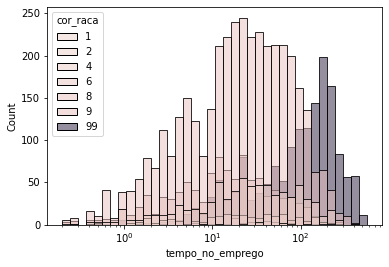

==================Categoria 8


count    3872.000000
mean       38.636157
std        46.834707
min         0.200000
25%         7.100000
50%        20.900000
75%        53.500000
max       352.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 9


count    1002.000000
mean       26.356487
std        37.988627
min         0.200000
25%         4.900000
50%        13.800000
75%        31.750000
max       436.300000
Name: tempo_no_emprego, dtype: float64

==================Categoria 99


count    1569.000000
mean      132.488400
std       107.074095
min         0.500000
25%        42.100000
50%       114.900000
75%       190.600000
max       561.600000
Name: tempo_no_emprego, dtype: float64

==================Categoria 2


count    747.000000
mean      46.335475
std       53.893026
min        0.200000
25%       10.550000
50%       26.200000
75%       62.900000
max      379.300000
Name: tempo_no_emprego, dtype: float64

==================Categoria 4


count    180.000000
mean      40.851667
std       50.055292
min        0.300000
25%        9.400000
50%       22.150000
75%       55.850000
max      376.700000
Name: tempo_no_emprego, dtype: float64

==================Categoria 6


count     41.000000
mean      47.490244
std       60.013439
min        0.300000
25%       16.200000
50%       26.900000
75%       49.700000
max      263.800000
Name: tempo_no_emprego, dtype: float64

==================Categoria 1


count     12.000000
mean      72.916667
std       69.196411
min        7.500000
25%       29.350000
50%       49.400000
75%       89.650000
max      230.700000
Name: tempo_no_emprego, dtype: float64

Grafico de distribuição de remuneracao com relação a cor_raca


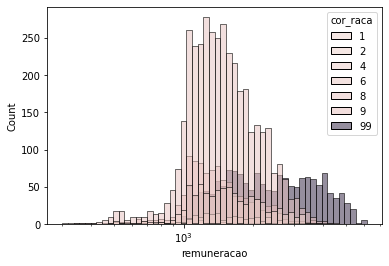

==================Categoria 8


count    3872.000000
mean     1553.521191
std       556.970617
min       326.150000
25%      1160.847500
50%      1431.515000
75%      1824.212500
max      4480.490000
Name: remuneracao, dtype: float64

==================Categoria 9


count    1002.000000
mean     1465.981078
std       525.318491
min       343.840000
25%      1115.985000
50%      1336.920000
75%      1693.652500
max      3911.050000
Name: remuneracao, dtype: float64

==================Categoria 99


count    1569.000000
mean     2554.218260
std      1155.214539
min       828.610000
25%      1585.430000
50%      2297.590000
75%      3398.610000
max      6141.800000
Name: remuneracao, dtype: float64

==================Categoria 2


count     747.000000
mean     1643.941539
std       619.321501
min       301.430000
25%      1183.840000
50%      1503.080000
75%      1980.390000
max      4176.580000
Name: remuneracao, dtype: float64

==================Categoria 4


count     180.000000
mean     1616.069056
std       610.738546
min       488.960000
25%      1208.897500
50%      1443.800000
75%      1922.370000
max      3876.690000
Name: remuneracao, dtype: float64

==================Categoria 6


count      41.000000
mean     1508.133659
std       611.181662
min       549.390000
25%      1080.350000
50%      1306.420000
75%      1753.120000
max      3439.710000
Name: remuneracao, dtype: float64

==================Categoria 1


count      12.000000
mean     1590.483333
std       770.211685
min       986.550000
25%      1209.350000
50%      1330.525000
75%      1600.955000
max      3724.680000
Name: remuneracao, dtype: float64

Grafico de distribuição de id com relação a cor_raca


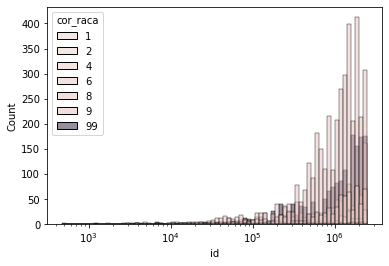

==================Categoria 8


count    3.872000e+03
mean     1.193166e+06
std      6.554839e+05
min      4.770000e+02
25%      6.347085e+05
50%      1.210618e+06
75%      1.736737e+06
max      2.459818e+06
Name: id, dtype: float64

==================Categoria 9


count    1.002000e+03
mean     1.162917e+06
std      7.956777e+05
min      3.360000e+03
25%      3.521698e+05
50%      1.142630e+06
75%      1.878783e+06
max      2.457804e+06
Name: id, dtype: float64

==================Categoria 99


count    1.569000e+03
mean     1.286209e+06
std      7.161474e+05
min      1.187000e+03
25%      7.136220e+05
50%      1.291766e+06
75%      1.861788e+06
max      2.455152e+06
Name: id, dtype: float64

==================Categoria 2


count    7.470000e+02
mean     1.123584e+06
std      7.265039e+05
min      3.185000e+03
25%      4.809900e+05
50%      1.152992e+06
75%      1.747582e+06
max      2.437366e+06
Name: id, dtype: float64

==================Categoria 4


count    1.800000e+02
mean     1.177962e+06
std      7.892222e+05
min      3.660000e+03
25%      3.035398e+05
50%      1.297304e+06
75%      1.790395e+06
max      2.417408e+06
Name: id, dtype: float64

==================Categoria 6


count    4.100000e+01
mean     9.598457e+05
std      7.628204e+05
min      1.761000e+03
25%      3.191840e+05
50%      7.602630e+05
75%      1.695410e+06
max      2.416691e+06
Name: id, dtype: float64

==================Categoria 1


count    1.200000e+01
mean     1.399896e+06
std      7.572501e+05
min      1.201830e+05
25%      9.978568e+05
50%      1.672477e+06
75%      1.893122e+06
max      2.172930e+06
Name: id, dtype: float64

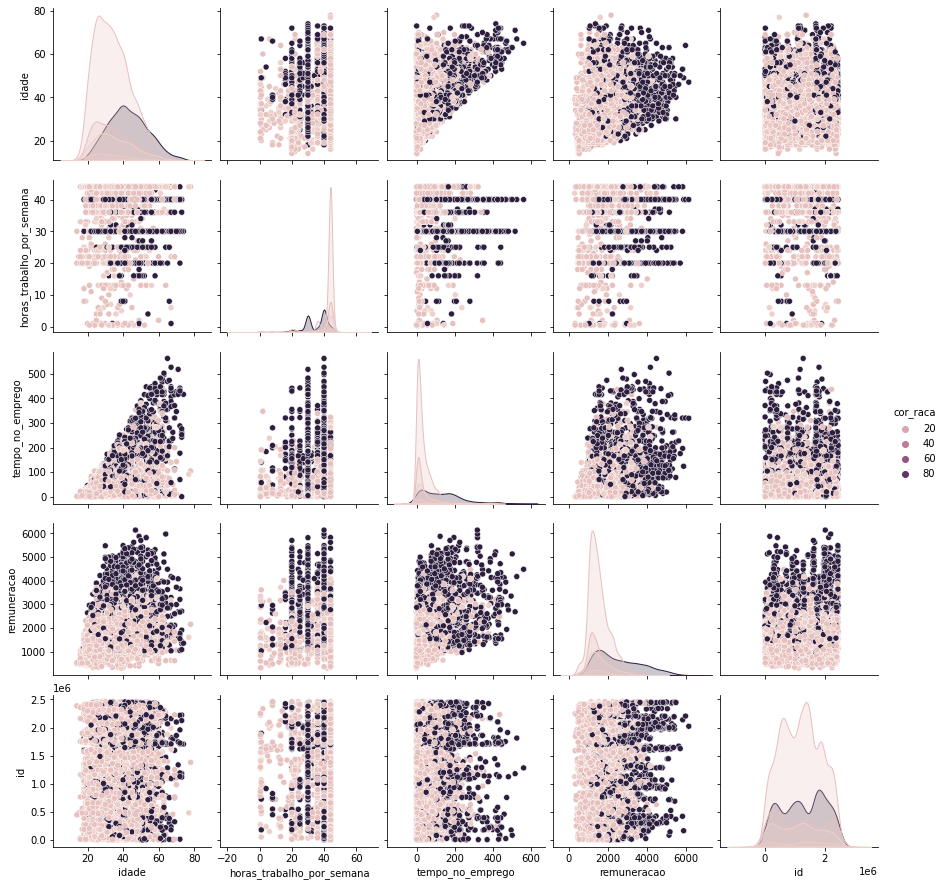

================escolaridade=============


,escolaridade,escolaridade
7,4657,0.627374
9,785,0.105752
5,563,0.075845
6,452,0.060892
4,354,0.047690
...,...,...
2,202,0.027213
3,133,0.017917
1,35,0.004715
10,5,0.000674


Grafico de distribuição de idade com relação a escolaridade


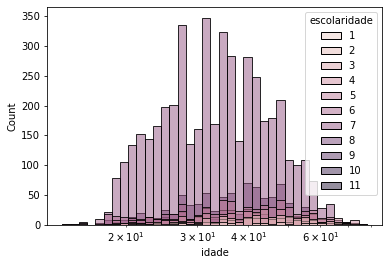

==================Categoria 7


count    4657.000000
mean       34.746189
std        10.328163
min        14.000000
25%        26.000000
50%        33.000000
75%        41.000000
max        78.000000
Name: idade, dtype: float64

==================Categoria 8


count    234.000000
mean      30.735043
std        9.658453
min       18.000000
25%       23.000000
50%       29.000000
75%       36.000000
max       72.000000
Name: idade, dtype: float64

==================Categoria 2


count    202.000000
mean      43.554455
std       11.323796
min       19.000000
25%       35.000000
50%       43.000000
75%       51.750000
max       70.000000
Name: idade, dtype: float64

==================Categoria 5


count    563.000000
mean      40.291297
std       11.804926
min       15.000000
25%       32.000000
50%       39.000000
75%       48.000000
max       73.000000
Name: idade, dtype: float64

==================Categoria 6


count    452.000000
mean      34.765487
std       12.271968
min       15.000000
25%       25.000000
50%       33.000000
75%       43.000000
max       77.000000
Name: idade, dtype: float64

==================Categoria 4


count    354.000000
mean      42.344633
std       12.986587
min       14.000000
25%       32.000000
50%       42.000000
75%       51.000000
max       74.000000
Name: idade, dtype: float64

==================Categoria 9


count    785.000000
mean      38.705732
std        9.395303
min       20.000000
25%       31.000000
50%       39.000000
75%       45.000000
max       67.000000
Name: idade, dtype: float64

==================Categoria 3


count    133.000000
mean      43.165414
std       11.911403
min       21.000000
25%       35.000000
50%       41.000000
75%       52.000000
max       72.000000
Name: idade, dtype: float64

==================Categoria 1


count    35.000000
mean     43.657143
std      12.632691
min      19.000000
25%      35.000000
50%      44.000000
75%      52.500000
max      69.000000
Name: idade, dtype: float64

==================Categoria 10


count     5.00000
mean     40.80000
std      12.83355
min      26.00000
25%      30.00000
50%      41.00000
75%      53.00000
max      54.00000
Name: idade, dtype: float64

==================Categoria 11


count     3.000000
mean     33.333333
std       7.571878
min      28.000000
25%      29.000000
50%      30.000000
75%      36.000000
max      42.000000
Name: idade, dtype: float64

Grafico de distribuição de horas_trabalho_por_semana com relação a escolaridade


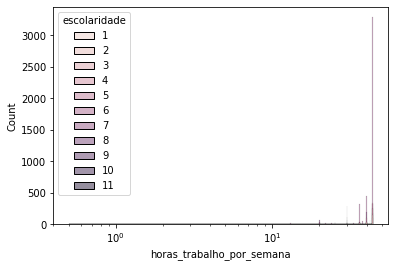

==================Categoria 7


count    4657.000000
mean       41.208289
std         6.002513
min         0.500000
25%        40.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 8


count    234.000000
mean      41.042735
std        7.223909
min        0.500000
25%       44.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 2


count    202.000000
mean      41.915842
std        4.474121
min        8.000000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 5


count    563.000000
mean      40.363233
std        6.401452
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 6


count    452.000000
mean      40.247788
std        7.680171
min        1.000000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 4


count    354.000000
mean      40.922316
std        6.173395
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 9


count    785.000000
mean      35.188535
std        9.996944
min        1.000000
25%       30.000000
50%       40.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 3


count    133.000000
mean      41.609023
std        5.041997
min       20.000000
25%       42.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 1


count    35.000000
mean     40.971429
std       6.085111
min      16.000000
25%      40.000000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 10


count     5.00000
mean     16.80000
std       9.20326
min       6.00000
25%       8.00000
50%      20.00000
75%      25.00000
max      25.00000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 11


count     3.000000
mean     23.333333
std       2.886751
min      20.000000
25%      22.500000
50%      25.000000
75%      25.000000
max      25.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a escolaridade


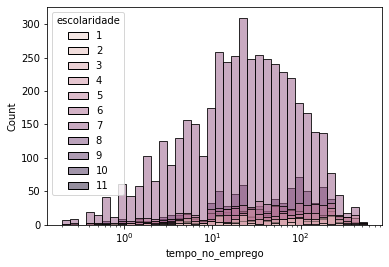

==================Categoria 7


count    4657.000000
mean       47.605046
std        64.281756
min         0.200000
25%         8.100000
50%        22.800000
75%        60.200000
max       561.600000
Name: tempo_no_emprego, dtype: float64

==================Categoria 8


count    234.000000
mean      45.498718
std       61.270888
min        0.200000
25%        8.225000
50%       21.000000
75%       54.400000
max      439.000000
Name: tempo_no_emprego, dtype: float64

==================Categoria 2


count    202.000000
mean      78.397030
std       88.898415
min        0.700000
25%       10.975000
50%       33.400000
75%      121.325000
max      425.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 5


count    563.000000
mean      82.142984
std       96.341683
min        0.300000
25%       13.450000
50%       40.300000
75%      122.400000
max      517.200000
Name: tempo_no_emprego, dtype: float64

==================Categoria 6


count    452.000000
mean      59.745796
std       77.212394
min        0.300000
25%       10.600000
50%       32.900000
75%       73.125000
max      465.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 4


count    354.000000
mean      95.890395
std      115.041135
min        0.200000
25%       13.975000
50%       43.300000
75%      139.875000
max      496.100000
Name: tempo_no_emprego, dtype: float64

==================Categoria 9


count    785.000000
mean      72.654904
std       73.609342
min        0.200000
25%       14.600000
50%       46.400000
75%      106.900000
max      378.000000
Name: tempo_no_emprego, dtype: float64

==================Categoria 3


count    133.000000
mean      98.215789
std      100.587412
min        1.800000
25%       16.300000
50%       66.900000
75%      160.700000
max      472.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 1


count     35.000000
mean      68.991429
std       89.187553
min        0.500000
25%        9.500000
50%       28.300000
75%       82.250000
max      335.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 10


count      5.000000
mean     127.420000
std       96.832598
min       15.900000
25%       28.500000
50%      178.900000
75%      206.900000
max      206.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 11


count     3.000000
mean     48.566667
std      34.017985
min      23.100000
25%      29.250000
50%      35.400000
75%      61.300000
max      87.200000
Name: tempo_no_emprego, dtype: float64

Grafico de distribuição de remuneracao com relação a escolaridade


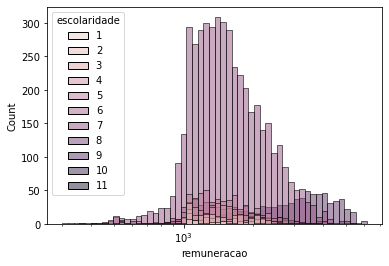

==================Categoria 7


count    4657.000000
mean     1641.287404
std       645.274052
min       326.150000
25%      1185.700000
50%      1480.460000
75%      1939.680000
max      5220.940000
Name: remuneracao, dtype: float64

==================Categoria 8


count     234.000000
mean     1814.437949
std       836.347494
min       419.970000
25%      1211.312500
50%      1596.235000
75%      2219.727500
max      5426.330000
Name: remuneracao, dtype: float64

==================Categoria 2


count     202.000000
mean     1512.136386
std       464.428289
min       636.520000
25%      1117.892500
50%      1389.495000
75%      1794.180000
max      2985.600000
Name: remuneracao, dtype: float64

==================Categoria 5


count     563.000000
mean     1545.813623
std       563.334537
min       407.580000
25%      1163.850000
50%      1421.330000
75%      1767.110000
max      4193.570000
Name: remuneracao, dtype: float64

==================Categoria 6


count     452.000000
mean     1424.231527
std       545.437546
min       466.530000
25%      1086.202500
50%      1319.425000
75%      1679.225000
max      4284.280000
Name: remuneracao, dtype: float64

==================Categoria 4


count     354.000000
mean     1546.407034
std       505.854137
min       301.430000
25%      1179.260000
50%      1451.080000
75%      1801.317500
max      3627.520000
Name: remuneracao, dtype: float64

==================Categoria 9


count     785.000000
mean     3027.926280
std      1206.914572
min       363.000000
25%      2068.430000
50%      3058.500000
75%      3924.670000
max      6141.800000
Name: remuneracao, dtype: float64

==================Categoria 3


count     133.000000
mean     1568.233308
std       487.068507
min       849.300000
25%      1183.270000
50%      1409.950000
75%      1892.230000
max      3245.140000
Name: remuneracao, dtype: float64

==================Categoria 1


count      35.000000
mean     1309.146571
std       372.368269
min       829.590000
25%      1062.220000
50%      1167.830000
75%      1475.345000
max      2558.100000
Name: remuneracao, dtype: float64

==================Categoria 10


count       5.000000
mean     3167.958000
std      1913.081347
min       482.140000
25%      1864.660000
50%      4121.400000
75%      4361.290000
max      5010.300000
Name: remuneracao, dtype: float64

==================Categoria 11


count       3.000000
mean     3138.406667
std       394.191279
min      2734.650000
25%      2946.470000
50%      3158.290000
75%      3340.285000
max      3522.280000
Name: remuneracao, dtype: float64

Grafico de distribuição de id com relação a escolaridade


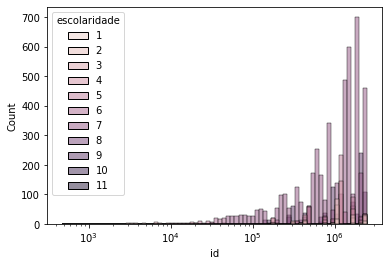

==================Categoria 7


count    4.657000e+03
mean     1.194056e+06
std      7.006611e+05
min      4.760700e+04
25%      5.875870e+05
50%      1.318744e+06
75%      1.808768e+06
max      2.416305e+06
Name: id, dtype: float64

==================Categoria 8


count    2.340000e+02
mean     1.356655e+06
std      7.832436e+05
min      1.437320e+05
25%      6.908660e+05
50%      1.599282e+06
75%      1.966598e+06
max      2.420201e+06
Name: id, dtype: float64

==================Categoria 2


count    2.020000e+02
mean     1.167948e+06
std      6.715647e+05
min      1.187000e+03
25%      9.838915e+05
50%      1.096602e+06
75%      1.695403e+06
max      2.354220e+06
Name: id, dtype: float64

==================Categoria 5


count    5.630000e+02
mean     1.114316e+06
std      5.926209e+05
min      2.061000e+04
25%      7.629115e+05
50%      1.182648e+06
75%      1.222354e+06
max      2.359895e+06
Name: id, dtype: float64

==================Categoria 6


count    4.520000e+02
mean     1.064766e+06
std      6.930523e+05
min      3.277200e+04
25%      4.815975e+05
50%      1.234424e+06
75%      1.740598e+06
max      2.363022e+06
Name: id, dtype: float64

==================Categoria 4


count    3.540000e+02
mean     1.080172e+06
std      6.249901e+05
min      1.085800e+04
25%      4.552332e+05
50%      1.132540e+06
75%      1.155490e+06
max      2.356035e+06
Name: id, dtype: float64

==================Categoria 9


count    7.850000e+02
mean     1.412534e+06
std      7.638884e+05
min      1.482520e+05
25%      7.449430e+05
50%      1.635133e+06
75%      2.067811e+06
max      2.458758e+06
Name: id, dtype: float64

==================Categoria 3


count    1.330000e+02
mean     1.030238e+06
std      5.803708e+05
min      6.384000e+03
25%      7.551180e+05
50%      1.106903e+06
75%      1.115843e+06
max      2.354888e+06
Name: id, dtype: float64

==================Categoria 1


count    3.500000e+01
mean     1.331169e+06
std      6.615771e+05
min      4.770000e+02
25%      1.078308e+06
50%      1.080080e+06
75%      2.153685e+06
max      2.352223e+06
Name: id, dtype: float64

==================Categoria 10


count    5.000000e+00
mean     1.721925e+06
std      6.927994e+05
min      9.807390e+05
25%      9.808190e+05
50%      2.094024e+06
75%      2.094579e+06
max      2.459462e+06
Name: id, dtype: float64

==================Categoria 11


count    3.000000e+00
mean     1.522322e+06
std      8.122056e+05
min      1.031127e+06
25%      1.053574e+06
50%      1.076021e+06
75%      1.767920e+06
max      2.459818e+06
Name: id, dtype: float64

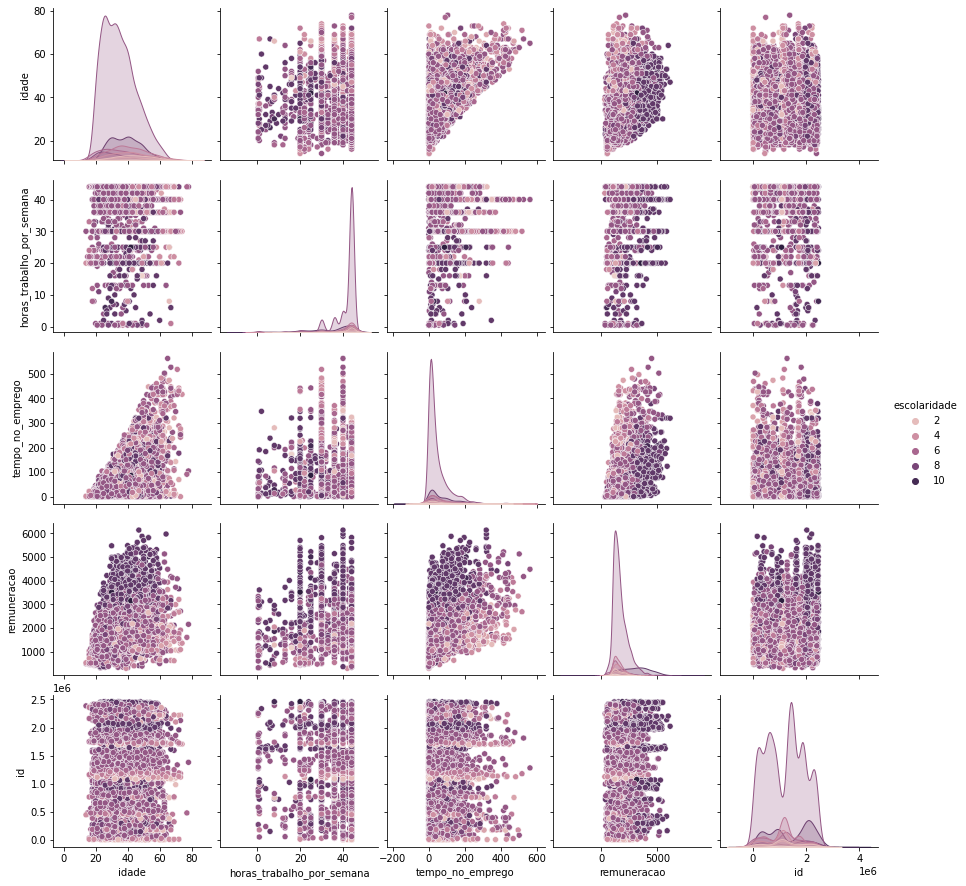

================portador_de_deficiencia=============


,portador_de_deficiencia,portador_de_deficiencia
0,7355,0.990839
1,68,0.009161


Grafico de distribuição de idade com relação a portador_de_deficiencia


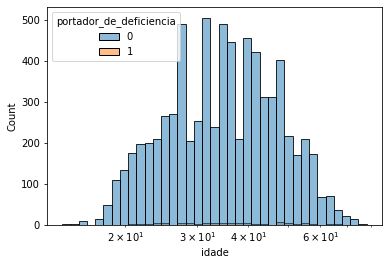

==================Categoria 0


count    7355.000000
mean       36.240517
std        11.061843
min        14.000000
25%        27.000000
50%        35.000000
75%        43.000000
max        78.000000
Name: idade, dtype: float64

==================Categoria 1


count    68.000000
mean     38.220588
std      11.495418
min      21.000000
25%      29.000000
50%      37.000000
75%      47.000000
max      65.000000
Name: idade, dtype: float64

Grafico de distribuição de horas_trabalho_por_semana com relação a portador_de_deficiencia


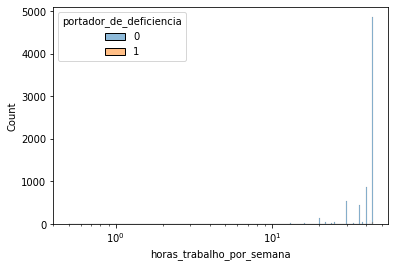

==================Categoria 0


count    7355.000000
mean       40.425425
std         6.969175
min         0.500000
25%        40.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 1


count    68.000000
mean     41.132353
std       5.493291
min      20.000000
25%      40.000000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a portador_de_deficiencia


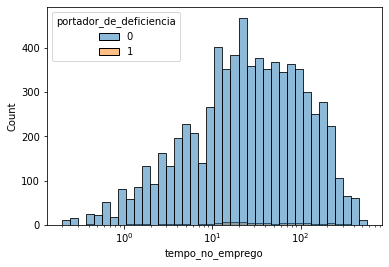

==================Categoria 0


count    7355.000000
mean       57.725656
std        75.228824
min         0.200000
25%         9.900000
50%        26.900000
75%        76.900000
max       561.600000
Name: tempo_no_emprego, dtype: float64

==================Categoria 1


count     68.000000
mean      60.272059
std       79.834491
min        0.400000
25%       14.075000
50%       26.100000
75%       75.325000
max      353.600000
Name: tempo_no_emprego, dtype: float64

Grafico de distribuição de remuneracao com relação a portador_de_deficiencia


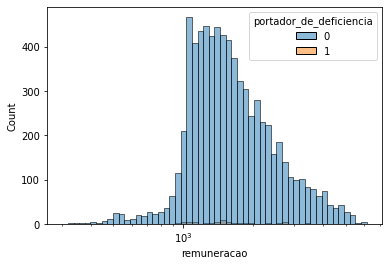

==================Categoria 0


count    7355.000000
mean     1764.684885
std       838.113925
min       301.430000
25%      1198.415000
50%      1515.230000
75%      2081.850000
max      6141.800000
Name: remuneracao, dtype: float64

==================Categoria 1


count      68.000000
mean     1651.386029
std       727.309948
min       535.320000
25%      1111.310000
50%      1474.910000
75%      1903.877500
max      4176.580000
Name: remuneracao, dtype: float64

Grafico de distribuição de id com relação a portador_de_deficiencia


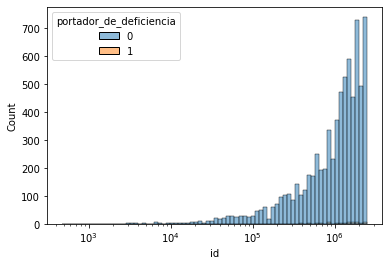

==================Categoria 0


count    7.355000e+03
mean     1.200533e+06
std      7.023894e+05
min      4.770000e+02
25%      5.918960e+05
50%      1.211405e+06
75%      1.792570e+06
max      2.459818e+06
Name: id, dtype: float64

==================Categoria 1


count    6.800000e+01
mean     1.188557e+06
std      6.504280e+05
min      4.692600e+04
25%      6.397225e+05
50%      1.173746e+06
75%      1.735525e+06
max      2.385913e+06
Name: id, dtype: float64

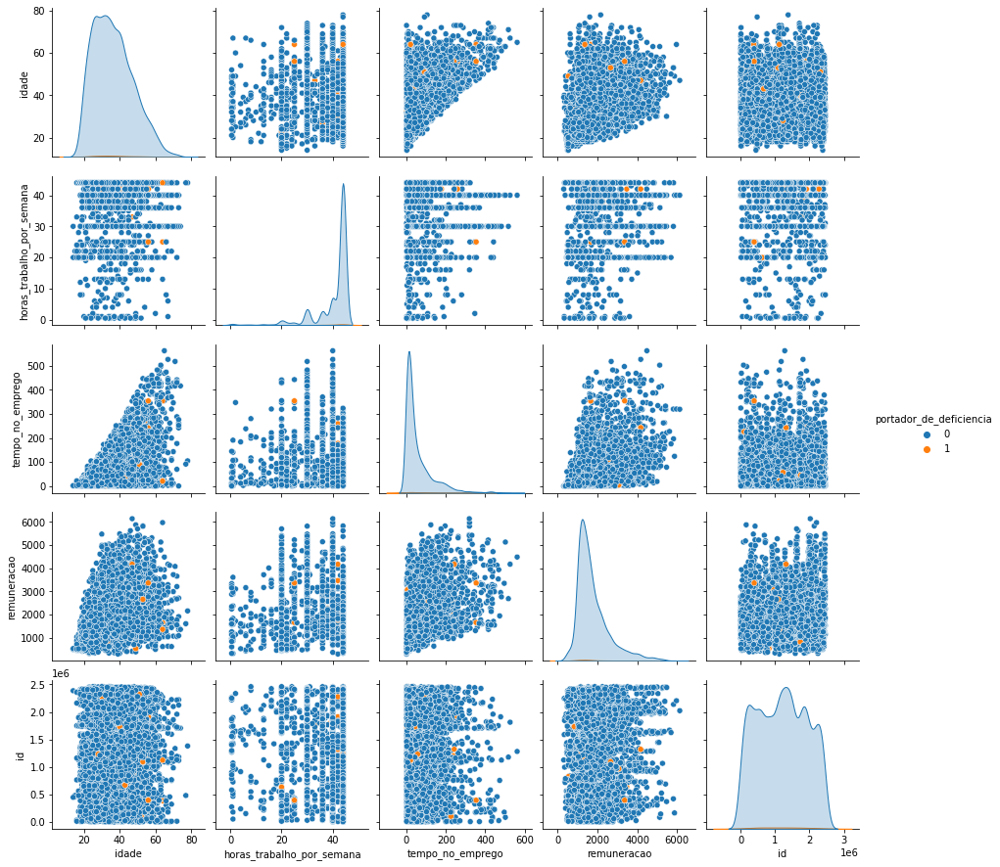

================tamanho_da_empresa=============


,tamanho_da_empresa,tamanho_da_empresa
10,1706,0.229826
5,849,0.114374
7,785,0.105752
4,740,0.099690
3,710,0.095649
9,688,0.092685
8,663,0.089317
2,661,0.089048
6,621,0.083659


Grafico de distribuição de idade com relação a tamanho_da_empresa


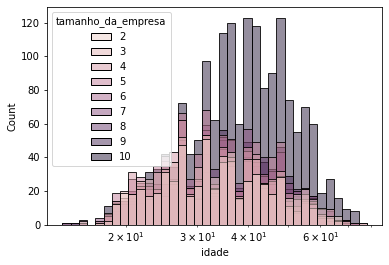

==================Categoria 2


count    661.000000
mean      35.075643
std       11.135407
min       16.000000
25%       26.000000
50%       33.000000
75%       42.000000
max       67.000000
Name: idade, dtype: float64

==================Categoria 7


count    785.000000
mean      35.768153
std       11.052969
min       14.000000
25%       27.000000
50%       34.000000
75%       43.000000
max       73.000000
Name: idade, dtype: float64

==================Categoria 5


count    849.000000
mean      34.330978
std       10.214561
min       16.000000
25%       26.000000
50%       33.000000
75%       41.000000
max       77.000000
Name: idade, dtype: float64

==================Categoria 8


count    663.000000
mean      36.464555
std       11.201729
min       15.000000
25%       28.000000
50%       35.000000
75%       44.000000
max       73.000000
Name: idade, dtype: float64

==================Categoria 6


count    621.000000
mean      34.636071
std       10.423744
min       16.000000
25%       27.000000
50%       33.000000
75%       41.000000
max       72.000000
Name: idade, dtype: float64

==================Categoria 9


count    688.000000
mean      37.265988
std       10.739358
min       14.000000
25%       29.000000
50%       36.500000
75%       45.000000
max       73.000000
Name: idade, dtype: float64

==================Categoria 10


count    1706.000000
mean       39.679953
std        11.165543
min        17.000000
25%        31.000000
50%        39.000000
75%        47.000000
max        74.000000
Name: idade, dtype: float64

==================Categoria 3


count    710.000000
mean      34.466197
std       11.044511
min       17.000000
25%       25.250000
50%       32.000000
75%       41.750000
max       78.000000
Name: idade, dtype: float64

==================Categoria 4


count    740.000000
mean      34.120270
std       10.528156
min       17.000000
25%       26.000000
50%       32.000000
75%       41.000000
max       72.000000
Name: idade, dtype: float64

Grafico de distribuição de horas_trabalho_por_semana com relação a tamanho_da_empresa


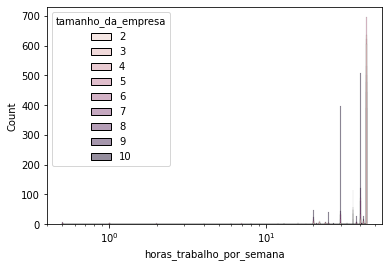

==================Categoria 2


count    661.000000
mean      42.662632
std        5.238229
min        1.000000
25%       44.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 7


count    785.000000
mean      40.554777
std        7.226752
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 5


count    849.000000
mean      41.428151
std        7.451582
min        0.500000
25%       44.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 8


count    663.000000
mean      40.541478
std        7.311489
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 6


count    621.000000
mean      41.066828
std        7.387760
min        0.500000
25%       44.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 9


count    688.000000
mean      39.837209
std        7.322600
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 10


count    1706.000000
mean       37.308324
std         6.710076
min         8.000000
25%        30.000000
50%        40.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 3


count    710.000000
mean      42.898592
std        4.093184
min       13.000000
25%       44.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 4


count    740.000000
mean      41.922297
std        6.490107
min        0.500000
25%       44.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a tamanho_da_empresa


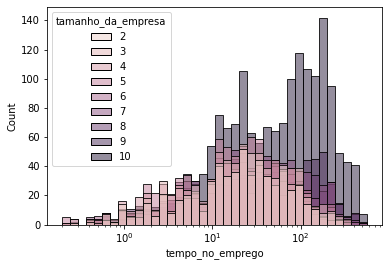

==================Categoria 2


count    661.000000
mean      37.287292
std       46.983066
min        0.300000
25%        8.100000
50%       21.900000
75%       46.900000
max      290.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 7


count    785.000000
mean      52.145605
std       66.648670
min        0.200000
25%        9.200000
50%       24.900000
75%       66.100000
max      465.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 5


count    849.000000
mean      36.064311
std       46.232950
min        0.200000
25%        5.900000
50%       19.900000
75%       45.000000
max      346.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 8


count    663.000000
mean      62.275716
std       79.022691
min        0.400000
25%        9.250000
50%       29.100000
75%       83.900000
max      429.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 6


count    621.000000
mean      41.272625
std       59.529052
min        0.200000
25%        7.100000
50%       19.900000
75%       51.400000
max      517.200000
Name: tempo_no_emprego, dtype: float64

==================Categoria 9


count    688.000000
mean      74.309884
std       83.087059
min        0.300000
25%       12.775000
50%       41.050000
75%      118.900000
max      481.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 10


count    1706.000000
mean       94.591794
std       100.183369
min         0.200000
25%        16.975000
50%        59.850000
75%       148.100000
max       561.600000
Name: tempo_no_emprego, dtype: float64

==================Categoria 3


count    710.000000
mean      39.690141
std       50.796401
min        0.200000
25%        7.825000
50%       20.900000
75%       49.900000
max      352.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 4


count    740.000000
mean      33.612162
std       40.779488
min        0.200000
25%        5.800000
50%       18.850000
75%       47.900000
max      282.900000
Name: tempo_no_emprego, dtype: float64

Grafico de distribuição de remuneracao com relação a tamanho_da_empresa


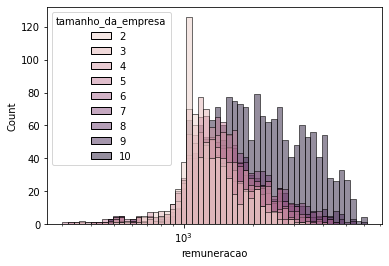

==================Categoria 2


count     661.000000
mean     1321.435189
std       405.734677
min       394.610000
25%      1052.690000
50%      1191.540000
75%      1498.930000
max      3149.050000
Name: remuneracao, dtype: float64

==================Categoria 7


count     785.000000
mean     1725.870484
std       703.101643
min       386.450000
25%      1246.760000
50%      1549.950000
75%      2043.680000
max      4420.170000
Name: remuneracao, dtype: float64

==================Categoria 5


count     849.000000
mean     1542.858622
std       559.689313
min       301.430000
25%      1170.380000
50%      1412.200000
75%      1775.010000
max      4145.600000
Name: remuneracao, dtype: float64

==================Categoria 8


count     663.000000
mean     1798.812323
std       741.413622
min       410.210000
25%      1317.795000
50%      1608.190000
75%      2129.385000
max      5374.610000
Name: remuneracao, dtype: float64

==================Categoria 6


count     621.000000
mean     1635.090467
std       638.515159
min       327.040000
25%      1178.200000
50%      1453.150000
75%      1971.100000
max      4309.510000
Name: remuneracao, dtype: float64

==================Categoria 9


count     688.000000
mean     1882.411177
std       869.988403
min       477.150000
25%      1309.032500
50%      1657.730000
75%      2191.605000
max      6141.800000
Name: remuneracao, dtype: float64

==================Categoria 10


count    1706.000000
mean     2329.830996
std      1107.775767
min       473.940000
25%      1450.915000
50%      2057.775000
75%      3030.040000
max      5974.310000
Name: remuneracao, dtype: float64

==================Categoria 3


count     710.000000
mean     1394.707070
std       444.282123
min       343.840000
25%      1112.112500
50%      1280.010000
75%      1599.847500
max      3352.610000
Name: remuneracao, dtype: float64

==================Categoria 4


count     740.000000
mean     1466.690919
std       479.489168
min       326.150000
25%      1137.752500
50%      1381.105000
75%      1689.200000
max      4082.040000
Name: remuneracao, dtype: float64

Grafico de distribuição de id com relação a tamanho_da_empresa


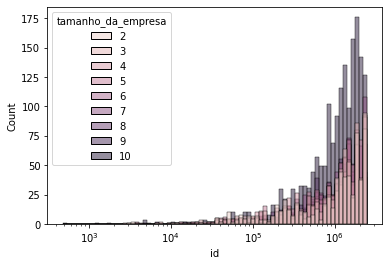

==================Categoria 2


count    6.610000e+02
mean     1.193605e+06
std      7.716668e+05
min      3.185000e+03
25%      3.964620e+05
50%      1.214509e+06
75%      1.868107e+06
max      2.435874e+06
Name: id, dtype: float64

==================Categoria 7


count    7.850000e+02
mean     1.271346e+06
std      7.137112e+05
min      4.953000e+03
25%      6.243470e+05
50%      1.269651e+06
75%      1.916003e+06
max      2.458758e+06
Name: id, dtype: float64

==================Categoria 5


count    8.490000e+02
mean     1.209802e+06
std      7.279601e+05
min      3.679000e+03
25%      5.454820e+05
50%      1.247600e+06
75%      1.862742e+06
max      2.459462e+06
Name: id, dtype: float64

==================Categoria 8


count    6.630000e+02
mean     1.166799e+06
std      6.592859e+05
min      1.761000e+03
25%      6.287870e+05
50%      1.171375e+06
75%      1.697790e+06
max      2.457533e+06
Name: id, dtype: float64

==================Categoria 6


count    6.210000e+02
mean     1.196694e+06
std      6.926638e+05
min      1.092300e+04
25%      6.273100e+05
50%      1.189235e+06
75%      1.730620e+06
max      2.455152e+06
Name: id, dtype: float64

==================Categoria 9


count    6.880000e+02
mean     1.165209e+06
std      6.308765e+05
min      4.770000e+02
25%      6.139578e+05
50%      1.198762e+06
75%      1.701321e+06
max      2.452544e+06
Name: id, dtype: float64

==================Categoria 10


count    1.706000e+03
mean     1.230771e+06
std      6.606408e+05
min      1.187000e+03
25%      6.796065e+05
50%      1.219060e+06
75%      1.772507e+06
max      2.459818e+06
Name: id, dtype: float64

==================Categoria 3


count    7.100000e+02
mean     1.181080e+06
std      7.362702e+05
min      2.662000e+03
25%      5.051820e+05
50%      1.228614e+06
75%      1.844426e+06
max      2.431983e+06
Name: id, dtype: float64

==================Categoria 4


count    7.400000e+02
mean     1.135112e+06
std      7.511196e+05
min      3.660000e+03
25%      4.426278e+05
50%      1.107640e+06
75%      1.790338e+06
max      2.458471e+06
Name: id, dtype: float64

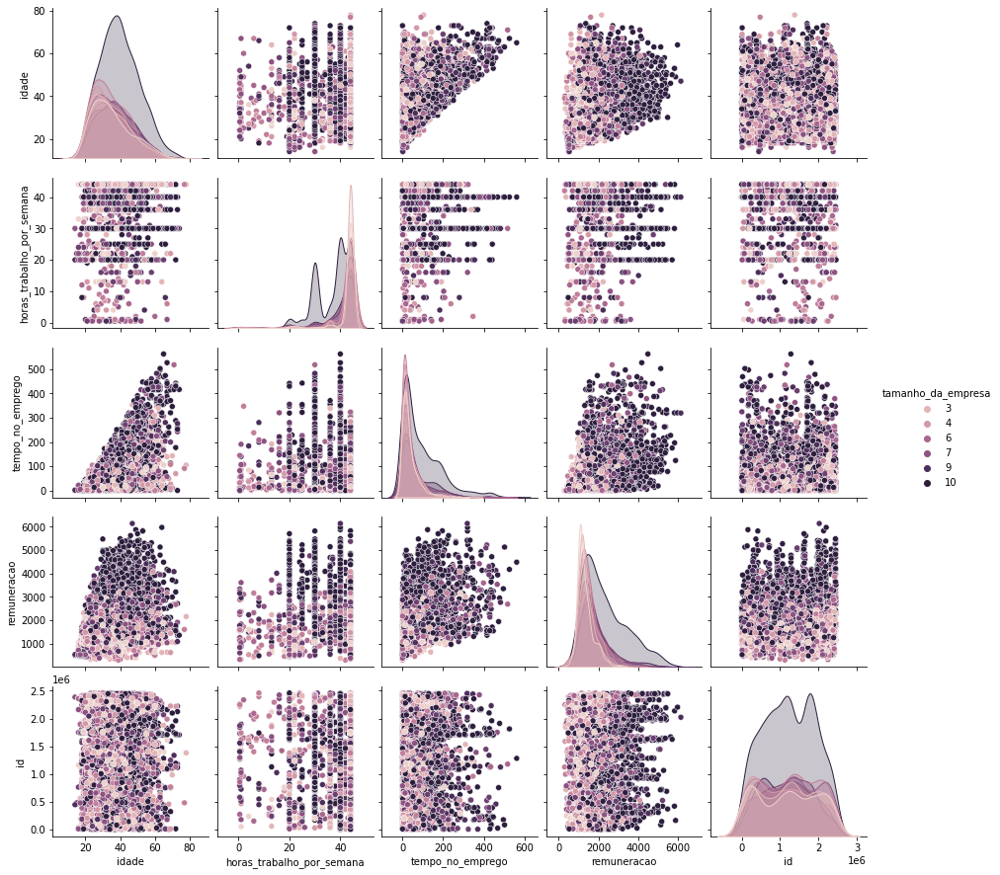

In [ ]:
def tira_0(x):
  if x == 0:
    return 0.5
  else:
    return x
cat = ['sexo', 'faixa_etaria', 'cor_raca', 'escolaridade', 'portador_de_deficiencia', 'tamanho_da_empresa']
num = normais.drop(cat, axis = 1).columns.copy()
palette=sns.color_palette("Paired")
dad = normais.copy()
for i in cat:
  p = num.to_list().copy()
  print(f'================{i}=============')
  display(pd.concat([normais[i].value_counts(), normais[i].value_counts(normalize = True)], axis = 1))
  for j in num:
    if 0 in dad[j].unique():
      dad[j] = dad[j].apply(tira_0)
    else:
      pass
    print(f'Grafico de distribuição de {j} com relação a {i}')
    fig = px.histogram(normais, x = j, color = i)
    fig.show()
    dad[dad[j]==0][j] = 10
    sns.histplot(data = dad, x = j, hue = i, log_scale = True, )
    sns.histplot(palette=palette)
    plt.show()
    for k in dad[i].unique():
      print(f'==================Categoria {k}')
      filt = dad[dad[i]==k].copy()
      display(filt[j].describe())

  p.append(i)
  sns.pairplot(data = dad[p], hue = i)
  plt.show()
  

================sexo=============


,sexo,sexo
1,1750,0.568736
2,1327,0.431264


Grafico de distribuição de idade com relação a sexo


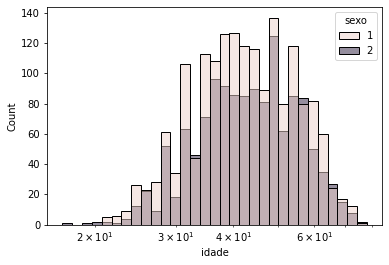

==================Categoria 1


count    1750.000000
mean       43.596571
std        10.906096
min        21.000000
25%        35.000000
50%        42.500000
75%        51.000000
max        76.000000
Name: idade, dtype: float64

==================Categoria 2


count    1327.000000
mean       44.222306
std        10.750405
min        17.000000
25%        36.000000
50%        44.000000
75%        52.000000
max        78.000000
Name: idade, dtype: float64

Grafico de distribuição de horas_trabalho_por_semana com relação a sexo


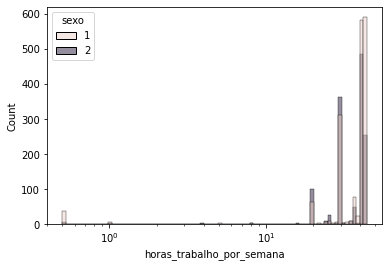

==================Categoria 1


count    1750.000000
mean       37.157143
std         8.856934
min         0.500000
25%        30.000000
50%        40.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 2


count    1327.000000
mean       35.320271
std         8.070737
min         0.500000
25%        30.000000
50%        40.000000
75%        40.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a sexo


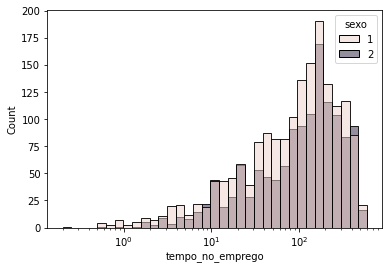

==================Categoria 1


count    1750.000000
mean      138.400514
std       122.582962
min         0.200000
25%        36.800000
50%       108.050000
75%       200.575000
max       596.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 2


count    1327.000000
mean      153.278523
std       126.070523
min         0.500000
25%        43.400000
50%       128.500000
75%       221.650000
max       556.900000
Name: tempo_no_emprego, dtype: float64

Grafico de distribuição de remuneracao com relação a sexo


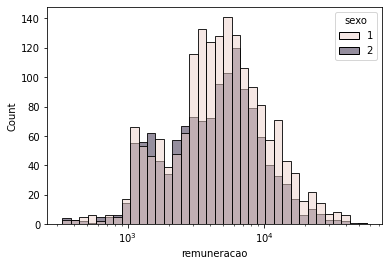

==================Categoria 1


count     1750.00000
mean      6368.36544
std       5751.11495
min        330.73000
25%       2916.87750
50%       4774.12500
75%       7791.12500
max      55122.47000
Name: remuneracao, dtype: float64

==================Categoria 2


count     1327.000000
mean      5658.272389
std       5105.770604
min        331.300000
25%       2378.015000
50%       4529.900000
75%       7117.280000
max      56849.230000
Name: remuneracao, dtype: float64

Grafico de distribuição de id com relação a sexo


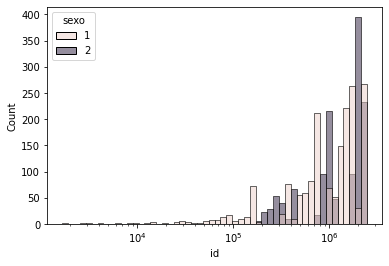

==================Categoria 1


count    1.750000e+03
mean     1.197808e+06
std      6.891838e+05
min      1.671000e+03
25%      6.507225e+05
50%      1.296702e+06
75%      1.652370e+06
max      2.351370e+06
Name: id, dtype: float64

==================Categoria 2


count    1.327000e+03
mean     1.459306e+06
std      7.325271e+05
min      1.754180e+05
25%      9.171470e+05
50%      1.803262e+06
75%      2.054215e+06
max      2.459844e+06
Name: id, dtype: float64

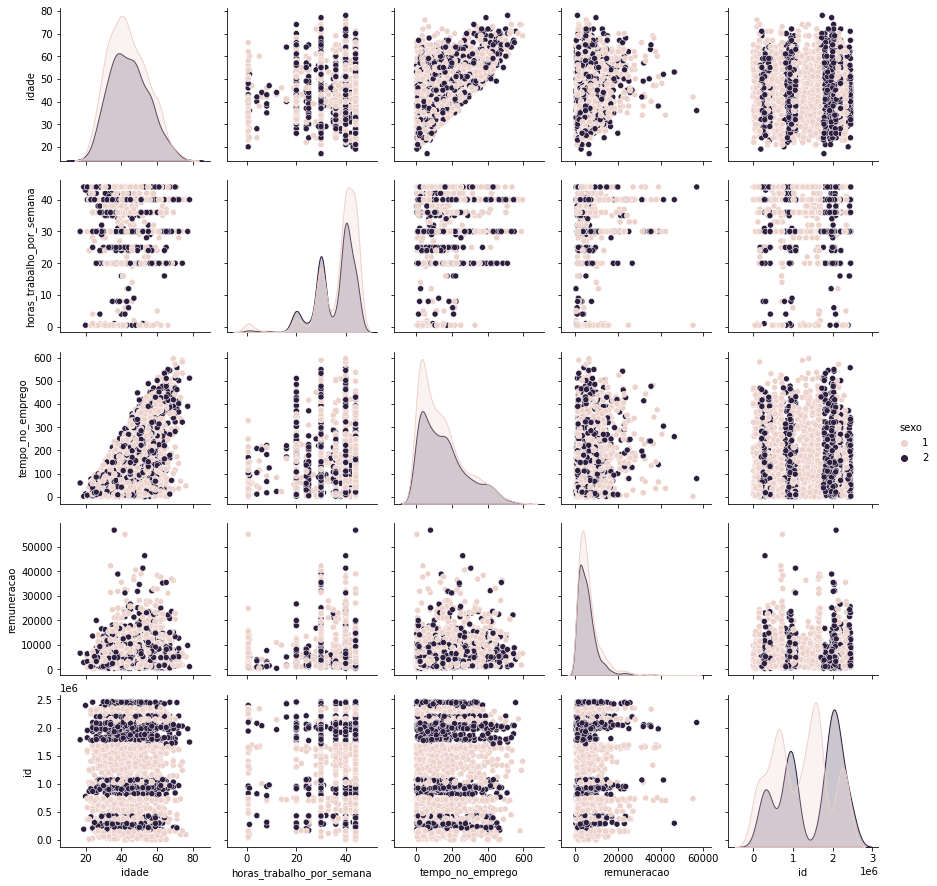

================faixa_etaria=============


,faixa_etaria,faixa_etaria
6,969,0.314917
5,917,0.298018
7,821,0.266818
4,214,0.069548
8,106,0.034449
3,49,0.015925
2,1,0.000325


Grafico de distribuição de idade com relação a faixa_etaria


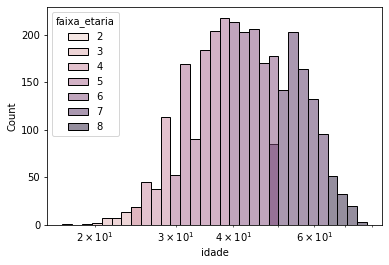

==================Categoria 7


count    821.000000
mean      55.694275
std        4.083617
min       50.000000
25%       52.000000
50%       55.000000
75%       59.000000
max       64.000000
Name: idade, dtype: float64

==================Categoria 6


count    969.000000
mean      44.310630
std        2.866431
min       40.000000
25%       42.000000
50%       44.000000
75%       47.000000
max       49.000000
Name: idade, dtype: float64

==================Categoria 5


count    917.000000
mean      34.962923
std        2.783047
min       30.000000
25%       33.000000
50%       35.000000
75%       37.000000
max       39.000000
Name: idade, dtype: float64

==================Categoria 4


count    214.000000
mean      27.462617
std        1.362132
min       25.000000
25%       26.000000
50%       28.000000
75%       29.000000
max       29.000000
Name: idade, dtype: float64

==================Categoria 8


count    106.000000
mean      68.349057
std        3.008060
min       65.000000
25%       66.000000
50%       68.000000
75%       70.000000
max       78.000000
Name: idade, dtype: float64

==================Categoria 3


count    49.000000
mean     22.755102
std       1.331206
min      19.000000
25%      22.000000
50%      23.000000
75%      24.000000
max      24.000000
Name: idade, dtype: float64

==================Categoria 2


count     1.0
mean     17.0
std       NaN
min      17.0
25%      17.0
50%      17.0
75%      17.0
max      17.0
Name: idade, dtype: float64

Grafico de distribuição de horas_trabalho_por_semana com relação a faixa_etaria


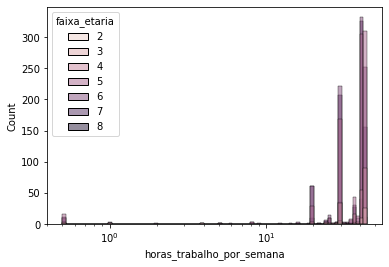

==================Categoria 7


count    821.000000
mean      35.404994
std        8.583172
min        0.500000
25%       30.000000
50%       40.000000
75%       40.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 6


count    969.000000
mean      35.987100
std        8.569061
min        0.500000
25%       30.000000
50%       40.000000
75%       42.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 5


count    917.000000
mean      37.413304
std        8.354480
min        0.500000
25%       30.000000
50%       40.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 4


count    214.000000
mean      38.100467
std        8.263441
min        0.500000
25%       36.000000
50%       40.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 8


count    106.000000
mean      34.551887
std        7.713911
min        0.500000
25%       30.000000
50%       38.500000
75%       40.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 3


count    49.000000
mean     36.775510
std      12.039891
min       0.500000
25%      36.000000
50%      42.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 2


count     1.0
mean     30.0
std       NaN
min      30.0
25%      30.0
50%      30.0
75%      30.0
max      30.0
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a faixa_etaria


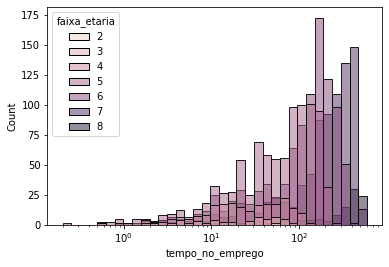

==================Categoria 7


count    821.000000
mean     235.498904
std      136.736309
min        0.500000
25%      129.300000
50%      237.900000
75%      350.600000
max      536.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 6


count    969.000000
mean     140.676574
std       90.893575
min        0.500000
25%       64.900000
50%      140.900000
75%      201.700000
max      448.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 5


count    917.000000
mean      77.473937
std       58.348498
min        0.200000
25%       24.600000
50%       67.700000
75%      119.300000
max      251.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 4


count    214.000000
mean      35.693925
std       29.282901
min        0.900000
25%       11.550000
50%       25.350000
75%       54.975000
max      121.600000
Name: tempo_no_emprego, dtype: float64

==================Categoria 8


count    106.00000
mean     337.30000
std      163.46121
min        2.10000
25%      208.30000
50%      381.90000
75%      468.52500
max      596.50000
Name: tempo_no_emprego, dtype: float64

==================Categoria 3


count    49.000000
mean     29.500000
std      23.880405
min       0.600000
25%       7.300000
50%      25.400000
75%      47.900000
max      76.800000
Name: tempo_no_emprego, dtype: float64

==================Categoria 2


count     1.0
mean     59.9
std       NaN
min      59.9
25%      59.9
50%      59.9
75%      59.9
max      59.9
Name: tempo_no_emprego, dtype: float64

Grafico de distribuição de remuneracao com relação a faixa_etaria


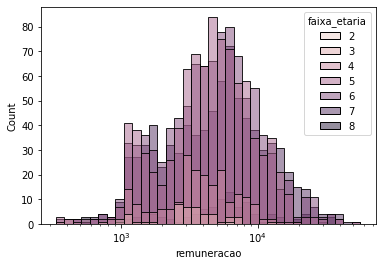

==================Categoria 7


count      821.000000
mean      6882.907527
std       6366.705445
min        363.330000
25%       2430.700000
50%       5201.690000
75%       8762.730000
max      46377.980000
Name: remuneracao, dtype: float64

==================Categoria 6


count      969.000000
mean      6147.144118
std       5550.454006
min        331.300000
25%       2685.670000
50%       4833.990000
75%       7615.300000
max      55122.470000
Name: remuneracao, dtype: float64

==================Categoria 5


count      917.000000
mean      5598.145267
std       4664.075386
min        330.730000
25%       2761.850000
50%       4585.640000
75%       7166.750000
max      56849.230000
Name: remuneracao, dtype: float64

==================Categoria 4


count      214.000000
mean      4381.848925
std       2905.060870
min        427.960000
25%       2686.710000
50%       3711.960000
75%       5412.697500
max      19944.510000
Name: remuneracao, dtype: float64

==================Categoria 8


count      106.000000
mean      7495.280849
std       7479.251535
min        519.360000
25%       3046.565000
50%       5597.745000
75%       8314.212500
max      36859.680000
Name: remuneracao, dtype: float64

==================Categoria 3


count       49.000000
mean      3540.296939
std       2270.916868
min        342.950000
25%       2513.070000
50%       3175.670000
75%       4281.630000
max      13553.440000
Name: remuneracao, dtype: float64

==================Categoria 2


count       1.00
mean     6528.05
std          NaN
min      6528.05
25%      6528.05
50%      6528.05
75%      6528.05
max      6528.05
Name: remuneracao, dtype: float64

Grafico de distribuição de id com relação a faixa_etaria


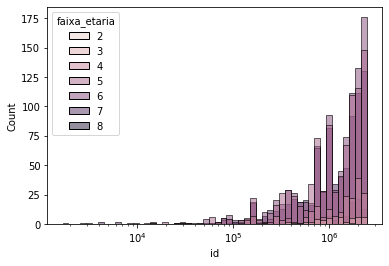

==================Categoria 7


count    8.210000e+02
mean     1.289048e+06
std      7.210979e+05
min      2.640000e+03
25%      7.142970e+05
50%      1.293919e+06
75%      2.008897e+06
max      2.459161e+06
Name: id, dtype: float64

==================Categoria 6


count    9.690000e+02
mean     1.340095e+06
std      7.254404e+05
min      1.671000e+03
25%      7.224690e+05
50%      1.435308e+06
75%      2.031772e+06
max      2.458375e+06
Name: id, dtype: float64

==================Categoria 5


count    9.170000e+02
mean     1.293773e+06
std      7.207028e+05
min      1.484800e+04
25%      7.022160e+05
50%      1.309476e+06
75%      2.001052e+06
max      2.459844e+06
Name: id, dtype: float64

==================Categoria 4


count    2.140000e+02
mean     1.315918e+06
std      7.010480e+05
min      4.765900e+04
25%      7.021032e+05
50%      1.457025e+06
75%      2.015185e+06
max      2.378674e+06
Name: id, dtype: float64

==================Categoria 8


count    1.060000e+02
mean     1.369539e+06
std      7.053183e+05
min      9.681000e+03
25%      8.209198e+05
50%      1.617570e+06
75%      1.997225e+06
max      2.450172e+06
Name: id, dtype: float64

==================Categoria 3


count    4.900000e+01
mean     1.241865e+06
std      6.928579e+05
min      1.514800e+04
25%      7.090100e+05
50%      1.229839e+06
75%      1.818737e+06
max      2.451626e+06
Name: id, dtype: float64

==================Categoria 2


count          1.0
mean     1783800.0
std            NaN
min      1783800.0
25%      1783800.0
50%      1783800.0
75%      1783800.0
max      1783800.0
Name: id, dtype: float64

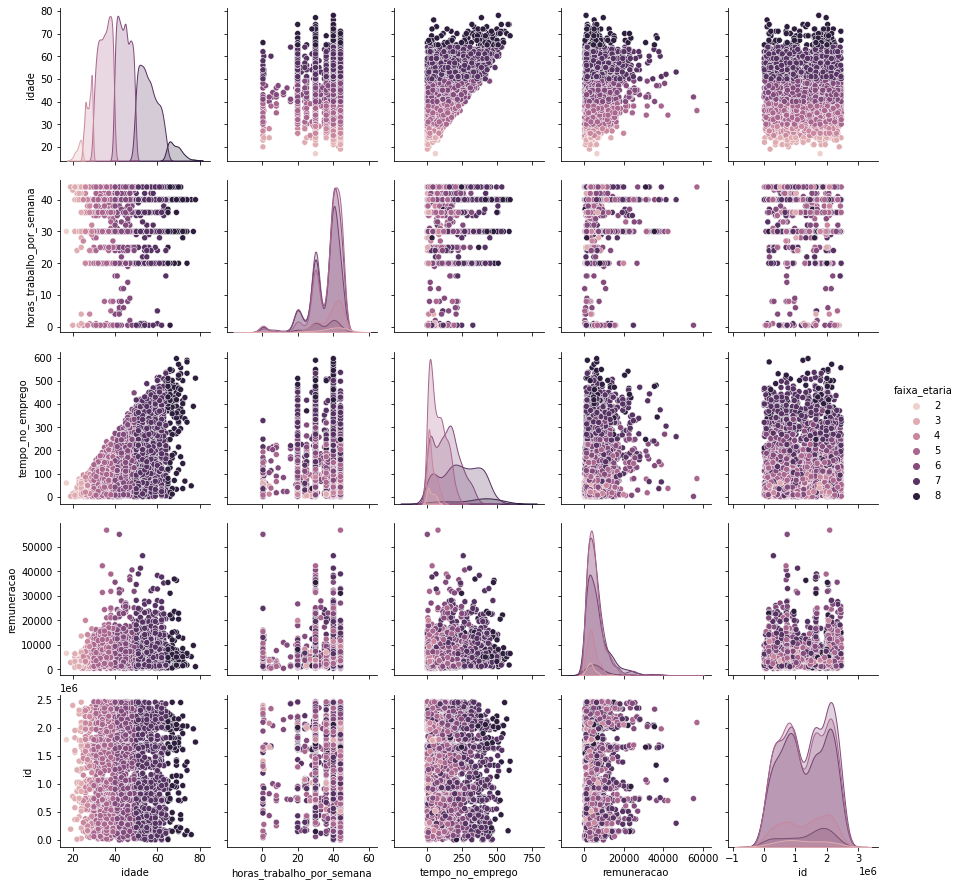

================cor_raca=============


,cor_raca,cor_raca
99,1886,0.612935
8,738,0.239844
2,277,0.090023
9,136,0.044199
4,25,0.008125
6,11,0.003575
1,4,0.001300


Grafico de distribuição de idade com relação a cor_raca


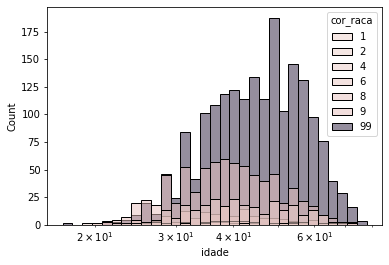

==================Categoria 99


count    1886.000000
mean       46.066808
std        10.715308
min        17.000000
25%        38.000000
50%        46.000000
75%        54.000000
max        78.000000
Name: idade, dtype: float64

==================Categoria 8


count    738.000000
mean      39.798103
std        9.902984
min       20.000000
25%       32.000000
50%       39.000000
75%       46.000000
max       72.000000
Name: idade, dtype: float64

==================Categoria 4


count    25.000000
mean     42.440000
std      10.312129
min      27.000000
25%      37.000000
50%      41.000000
75%      45.000000
max      67.000000
Name: idade, dtype: float64

==================Categoria 2


count    277.000000
mean      42.433213
std       10.698099
min       19.000000
25%       34.000000
50%       41.000000
75%       50.000000
max       71.000000
Name: idade, dtype: float64

==================Categoria 9


count    136.000000
mean      39.117647
std        9.506379
min       21.000000
25%       32.750000
50%       38.000000
75%       44.000000
max       71.000000
Name: idade, dtype: float64

==================Categoria 6


count    11.000000
mean     40.000000
std       8.461678
min      28.000000
25%      35.000000
50%      39.000000
75%      42.000000
max      55.000000
Name: idade, dtype: float64

==================Categoria 1


count     4.000000
mean     37.250000
std      12.065792
min      24.000000
25%      29.250000
50%      37.000000
75%      45.000000
max      51.000000
Name: idade, dtype: float64

Grafico de distribuição de horas_trabalho_por_semana com relação a cor_raca


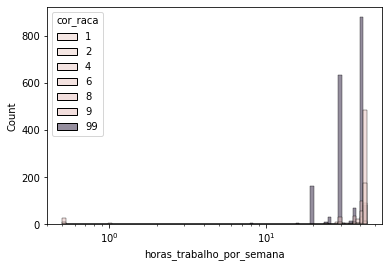

==================Categoria 99


count    1886.000000
mean       34.469777
std         6.866664
min         4.000000
25%        30.000000
50%        40.000000
75%        40.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 8


count    738.000000
mean      39.206640
std       10.297688
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 4


count    25.000000
mean     39.500000
std       8.904587
min       0.500000
25%      38.000000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 2


count    277.000000
mean      39.416968
std        9.996664
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 9


count    136.000000
mean      40.669118
std        7.842718
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 6


count    11.000000
mean     37.318182
std      13.134445
min       0.500000
25%      36.000000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 1


count     4.000000
mean     25.750000
std      18.553975
min       1.000000
25%      16.750000
50%      31.000000
75%      40.000000
max      40.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a cor_raca


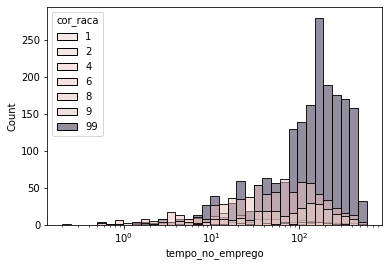

==================Categoria 99


count    1886.000000
mean      179.140403
std       127.538714
min         0.200000
25%        77.500000
50%       160.900000
75%       261.550000
max       596.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 8


count    738.000000
mean      85.135908
std       90.400972
min        0.500000
25%       20.500000
50%       55.900000
75%      119.875000
max      508.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 4


count     25.000000
mean      94.132000
std       75.965385
min        1.800000
25%       22.900000
50%       89.900000
75%      145.900000
max      248.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 2


count    277.000000
mean     120.049458
std      109.796254
min        0.700000
25%       35.600000
50%       94.900000
75%      173.300000
max      545.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 9


count    136.000000
mean      55.491912
std       89.385046
min        0.500000
25%        9.075000
50%       20.300000
75%       53.025000
max      556.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 6


count     11.000000
mean     115.690909
std       66.627043
min        1.900000
25%       65.300000
50%      122.400000
75%      152.900000
max      247.100000
Name: tempo_no_emprego, dtype: float64

==================Categoria 1


count      4.000000
mean     121.475000
std      151.648088
min        6.400000
25%       41.050000
50%       67.750000
75%      148.175000
max      344.000000
Name: tempo_no_emprego, dtype: float64

Grafico de distribuição de remuneracao com relação a cor_raca


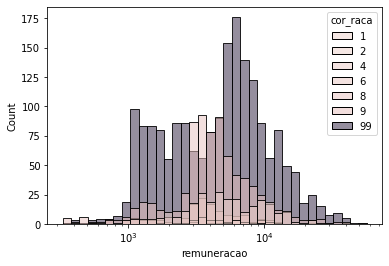

==================Categoria 99


count     1886.00000
mean      6407.89720
std       5838.55777
min        331.30000
25%       2226.27000
50%       5197.95500
75%       8074.93750
max      46377.98000
Name: remuneracao, dtype: float64

==================Categoria 8


count      738.000000
mean      5238.101098
std       4494.756309
min        330.730000
25%       3070.787500
50%       4115.960000
75%       5962.835000
max      55122.470000
Name: remuneracao, dtype: float64

==================Categoria 4


count       25.000000
mean      5484.040400
std       3249.575134
min        519.360000
25%       3514.800000
50%       3943.280000
75%       8838.230000
max      11999.580000
Name: remuneracao, dtype: float64

==================Categoria 2


count      277.000000
mean      6717.066282
std       6033.285806
min        430.870000
25%       3278.680000
50%       4959.330000
75%       8875.310000
max      56849.230000
Name: remuneracao, dtype: float64

==================Categoria 9


count      136.000000
mean      4586.136985
std       3955.932003
min        342.950000
25%       2881.982500
50%       3675.825000
75%       5197.120000
max      27909.880000
Name: remuneracao, dtype: float64

==================Categoria 6


count      11.000000
mean     4752.158182
std      2274.259956
min      1661.220000
25%      3056.550000
50%      4362.460000
75%      6124.135000
max      8963.400000
Name: remuneracao, dtype: float64

==================Categoria 1


count        4.00000
mean      7109.37750
std       2012.95505
min       5880.50000
25%       5933.09000
50%       6228.80500
75%       7405.09250
max      10099.40000
Name: remuneracao, dtype: float64

Grafico de distribuição de id com relação a cor_raca


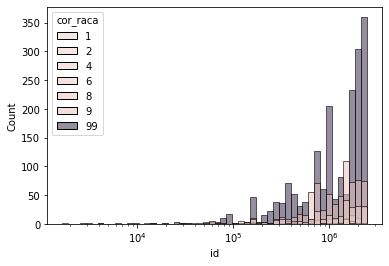

==================Categoria 99


count    1.886000e+03
mean     1.351509e+06
std      7.432216e+05
min      2.640000e+03
25%      7.184860e+05
50%      1.413450e+06
75%      2.047676e+06
max      2.459844e+06
Name: id, dtype: float64

==================Categoria 8


count    7.380000e+02
mean     1.240664e+06
std      6.409419e+05
min      4.272000e+03
25%      7.051878e+05
50%      1.262708e+06
75%      1.674808e+06
max      2.458009e+06
Name: id, dtype: float64

==================Categoria 4


count    2.500000e+01
mean     1.330054e+06
std      6.839118e+05
min      7.632800e+04
25%      1.085615e+06
50%      1.513152e+06
75%      1.675787e+06
max      2.347672e+06
Name: id, dtype: float64

==================Categoria 2


count    2.770000e+02
mean     1.239332e+06
std      7.096255e+05
min      1.514800e+04
25%      6.708990e+05
50%      1.369015e+06
75%      1.690543e+06
max      2.458375e+06
Name: id, dtype: float64

==================Categoria 9


count    1.360000e+02
mean     1.283487e+06
std      7.846810e+05
min      1.671000e+03
25%      6.169438e+05
50%      1.365816e+06
75%      2.022000e+06
max      2.447959e+06
Name: id, dtype: float64

==================Categoria 6


count    1.100000e+01
mean     1.179445e+06
std      8.040358e+05
min      1.632910e+05
25%      5.610100e+05
50%      9.217830e+05
75%      1.851581e+06
max      2.296833e+06
Name: id, dtype: float64

==================Categoria 1


count    4.000000e+00
mean     1.008239e+06
std      6.406954e+05
min      1.723560e+05
25%      7.261320e+05
50%      1.088161e+06
75%      1.370268e+06
max      1.684278e+06
Name: id, dtype: float64

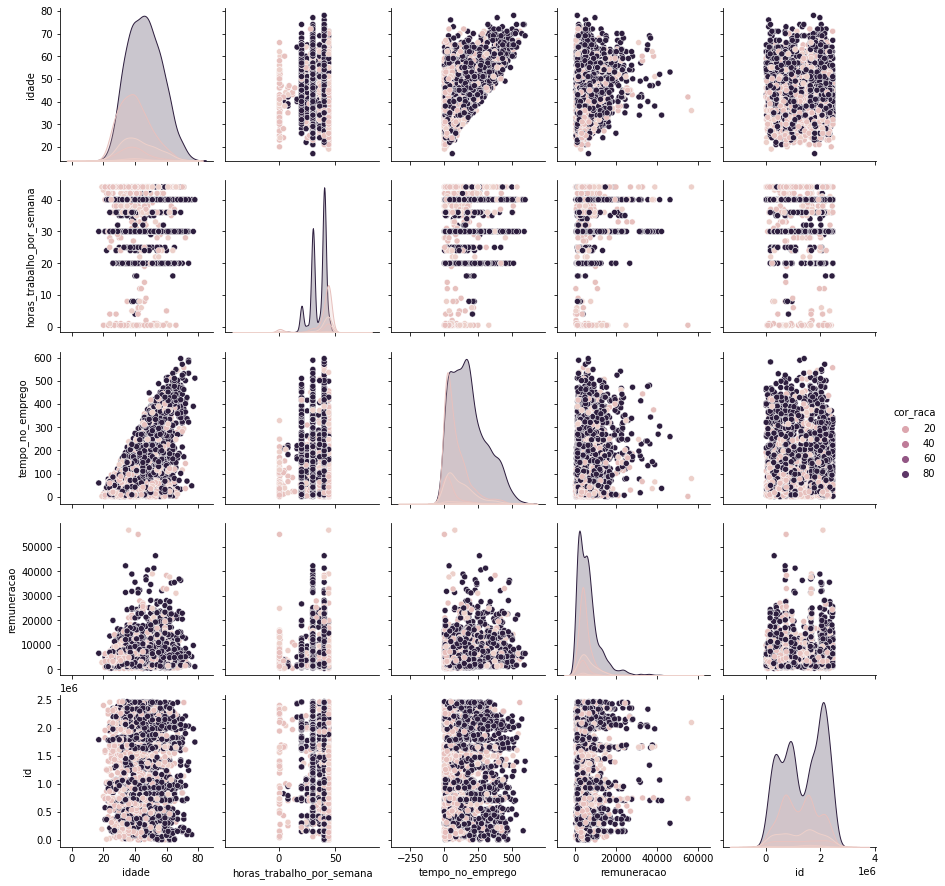

================escolaridade=============


,escolaridade,escolaridade
9,1732,0.562886
7,960,0.311992
8,96,0.031199
5,71,0.023074
10,67,0.021774
...,...,...
4,38,0.012350
11,38,0.012350
3,16,0.005200
2,16,0.005200


Grafico de distribuição de idade com relação a escolaridade


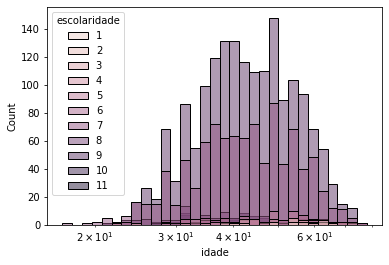

==================Categoria 9


count    1732.000000
mean       43.976328
std        10.521910
min        21.000000
25%        36.000000
50%        43.000000
75%        51.000000
max        77.000000
Name: idade, dtype: float64

==================Categoria 7


count    960.000000
mean      43.367708
std       10.947652
min       17.000000
25%       35.000000
50%       42.500000
75%       51.000000
max       76.000000
Name: idade, dtype: float64

==================Categoria 4


count    38.000000
mean     50.973684
std      12.491049
min      22.000000
25%      44.000000
50%      51.500000
75%      60.750000
max      71.000000
Name: idade, dtype: float64

==================Categoria 10


count    67.000000
mean     42.492537
std       9.130988
min      27.000000
25%      35.000000
50%      42.000000
75%      47.500000
max      68.000000
Name: idade, dtype: float64

==================Categoria 11


count    38.000000
mean     41.526316
std      10.263388
min      27.000000
25%      32.500000
50%      39.500000
75%      48.250000
max      62.000000
Name: idade, dtype: float64

==================Categoria 8


count    96.000000
mean     40.708333
std      12.186202
min      21.000000
25%      31.750000
50%      38.500000
75%      48.250000
max      68.000000
Name: idade, dtype: float64

==================Categoria 5


count    71.000000
mean     47.253521
std      10.614974
min      24.000000
25%      39.000000
50%      49.000000
75%      54.000000
max      70.000000
Name: idade, dtype: float64

==================Categoria 6


count    41.000000
mean     42.878049
std      14.522732
min      22.000000
25%      32.000000
50%      40.000000
75%      54.000000
max      78.000000
Name: idade, dtype: float64

==================Categoria 3


count    16.000000
mean     50.687500
std       9.924507
min      39.000000
25%      42.750000
50%      48.000000
75%      58.250000
max      65.000000
Name: idade, dtype: float64

==================Categoria 2


count    16.000000
mean     54.750000
std       7.132087
min      40.000000
25%      52.750000
50%      54.500000
75%      59.750000
max      66.000000
Name: idade, dtype: float64

==================Categoria 1


count     2.000000
mean     53.500000
std       0.707107
min      53.000000
25%      53.250000
50%      53.500000
75%      53.750000
max      54.000000
Name: idade, dtype: float64

Grafico de distribuição de horas_trabalho_por_semana com relação a escolaridade


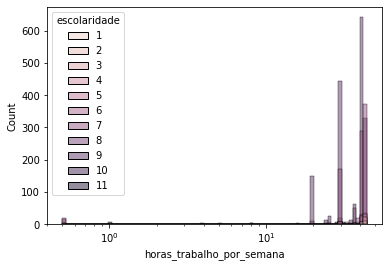

==================Categoria 9


count    1732.000000
mean       35.135970
std         8.533372
min         0.500000
25%        30.000000
50%        40.000000
75%        40.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 7


count    960.000000
mean      37.984375
std        8.351491
min        0.500000
25%       36.000000
50%       40.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 4


count    38.000000
mean     40.526316
std       5.129337
min      30.000000
25%      40.000000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 10


count    67.000000
mean     36.410448
std       9.196477
min       0.500000
25%      31.000000
50%      40.000000
75%      40.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 11


count    38.000000
mean     34.500000
std       7.766004
min       8.000000
25%      30.000000
50%      40.000000
75%      40.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 8


count    96.000000
mean     37.442708
std       7.983163
min       0.500000
25%      30.000000
50%      40.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 5


count    71.000000
mean     38.887324
std       8.213750
min       0.500000
25%      40.000000
50%      40.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 6


count    41.000000
mean     37.597561
std      11.800540
min       0.500000
25%      36.000000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 3


count    16.000000
mean     39.937500
std       5.297405
min      25.000000
25%      40.000000
50%      40.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 2


count    16.000000
mean     41.500000
std       5.033223
min      24.000000
25%      40.000000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 1


count     2.000000
mean     42.000000
std       2.828427
min      40.000000
25%      41.000000
50%      42.000000
75%      43.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a escolaridade


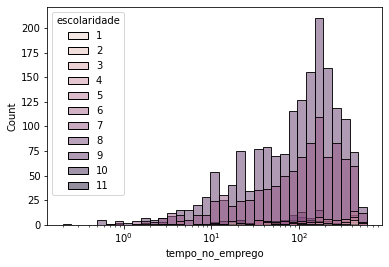

==================Categoria 9


count    1732.000000
mean      140.371247
std       117.513956
min         0.200000
25%        40.200000
50%       116.700000
75%       203.500000
max       581.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 7


count    960.000000
mean     150.081771
std      127.355452
min        0.700000
25%       40.425000
50%      121.650000
75%      224.375000
max      596.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 4


count     38.000000
mean     221.281579
std      174.858741
min        1.900000
25%       46.025000
50%      171.850000
75%      375.825000
max      530.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 10


count     67.000000
mean     116.788060
std      107.625906
min        0.900000
25%       43.000000
50%       82.900000
75%      140.500000
max      472.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 11


count     38.000000
mean      77.668421
std       92.965806
min        0.900000
25%       21.425000
50%       46.100000
75%       95.150000
max      429.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 8


count     96.000000
mean     139.280208
std      134.464863
min        1.800000
25%       32.600000
50%      105.600000
75%      177.100000
max      536.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 5


count     71.000000
mean     185.749296
std      151.746073
min        2.900000
25%       40.350000
50%      171.600000
75%      330.650000
max      469.800000
Name: tempo_no_emprego, dtype: float64

==================Categoria 6


count     41.000000
mean     151.246341
std      163.422760
min        2.300000
25%       35.400000
50%       76.900000
75%      201.500000
max      589.300000
Name: tempo_no_emprego, dtype: float64

==================Categoria 3


count     16.000000
mean     164.950000
std      137.789821
min        1.400000
25%       27.650000
50%      166.950000
75%      273.425000
max      411.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 2


count     16.000000
mean     211.550000
std      170.510477
min        7.600000
25%       17.900000
50%      200.400000
75%      380.550000
max      461.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 1


count      2.000000
mean     215.450000
std      111.227897
min      136.800000
25%      176.125000
50%      215.450000
75%      254.775000
max      294.100000
Name: tempo_no_emprego, dtype: float64

Grafico de distribuição de remuneracao com relação a escolaridade


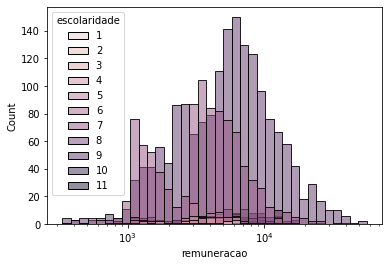

==================Categoria 9


count     1732.000000
mean      7131.483262
std       6295.148047
min        331.300000
25%       2864.802500
50%       5585.725000
75%       8855.807500
max      56849.230000
Name: remuneracao, dtype: float64

==================Categoria 7


count      960.000000
mean      4282.737740
std       3408.585435
min        330.730000
25%       1731.587500
50%       3650.370000
75%       5426.862500
max      36324.990000
Name: remuneracao, dtype: float64

==================Categoria 4


count       38.000000
mean      4342.964474
std       2290.433876
min       1360.920000
25%       2862.345000
50%       3731.245000
75%       5340.395000
max      11977.240000
Name: remuneracao, dtype: float64

==================Categoria 10


count       67.00000
mean      9241.78194
std       5995.18079
min        488.87000
25%       5949.89500
50%       8134.06000
75%      12288.03500
max      37750.08000
Name: remuneracao, dtype: float64

==================Categoria 11


count       38.000000
mean      8146.468421
std       7035.827356
min       1312.340000
25%       2922.827500
50%       6750.585000
75%      11027.977500
max      38359.080000
Name: remuneracao, dtype: float64

==================Categoria 8


count       96.000000
mean      4972.760104
std       3150.965975
min        369.780000
25%       2375.865000
50%       4584.510000
75%       7033.912500
max      13535.030000
Name: remuneracao, dtype: float64

==================Categoria 5


count       71.000000
mean      4522.869577
std       3210.491493
min        700.540000
25%       2894.530000
50%       3807.850000
75%       5190.765000
max      16538.670000
Name: remuneracao, dtype: float64

==================Categoria 6


count       41.000000
mean      3896.653171
std       2374.445094
min        363.330000
25%       2497.310000
50%       3595.590000
75%       4999.460000
max      12776.410000
Name: remuneracao, dtype: float64

==================Categoria 3


count      16.000000
mean     2942.113750
std      1510.217085
min       507.100000
25%      1451.200000
50%      3042.820000
75%      3984.255000
max      6332.600000
Name: remuneracao, dtype: float64

==================Categoria 2


count      16.000000
mean     4930.076250
std      2380.546457
min      1720.990000
25%      3002.317500
50%      4725.090000
75%      6406.162500
max      9746.980000
Name: remuneracao, dtype: float64

==================Categoria 1


count       2.000000
mean     5992.685000
std      4895.689155
min      2530.910000
25%      4261.797500
50%      5992.685000
75%      7723.572500
max      9454.460000
Name: remuneracao, dtype: float64

Grafico de distribuição de id com relação a escolaridade


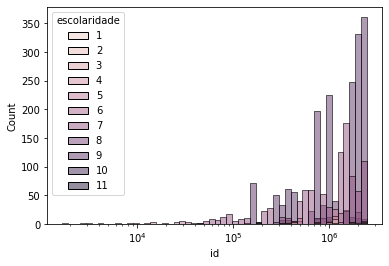

==================Categoria 9


count    1.732000e+03
mean     1.421617e+06
std      7.285091e+05
min      1.482400e+05
25%      7.388342e+05
50%      1.637619e+06
75%      2.060506e+06
max      2.458375e+06
Name: id, dtype: float64

==================Categoria 7


count    9.600000e+02
mean     1.199966e+06
std      6.881848e+05
min      4.765900e+04
25%      5.731742e+05
50%      1.329650e+06
75%      1.773410e+06
max      2.413953e+06
Name: id, dtype: float64

==================Categoria 4


count    3.800000e+01
mean     8.681577e+05
std      6.379326e+05
min      1.278000e+04
25%      3.539100e+05
50%      1.074746e+06
75%      1.145040e+06
max      2.225701e+06
Name: id, dtype: float64

==================Categoria 10


count    6.700000e+01
mean     1.241476e+06
std      7.754050e+05
min      1.719370e+05
25%      4.377790e+05
50%      9.812170e+05
75%      2.092288e+06
max      2.459292e+06
Name: id, dtype: float64

==================Categoria 11


count    3.800000e+01
mean     1.249127e+06
std      5.480048e+05
min      3.178220e+05
25%      9.820718e+05
50%      1.053084e+06
75%      1.692278e+06
max      2.459844e+06
Name: id, dtype: float64

==================Categoria 8


count    9.600000e+01
mean     1.170813e+06
std      6.152948e+05
min      1.440670e+05
25%      6.907312e+05
50%      9.057660e+05
75%      1.604285e+06
max      2.323741e+06
Name: id, dtype: float64

==================Categoria 5


count    7.100000e+01
mean     1.030200e+06
std      6.178434e+05
min      2.525300e+04
25%      4.716870e+05
50%      1.164873e+06
75%      1.210884e+06
max      2.233861e+06
Name: id, dtype: float64

==================Categoria 6


count    4.100000e+01
mean     1.045049e+06
std      6.251375e+05
min      3.386700e+04
25%      4.804870e+05
50%      1.234404e+06
75%      1.260214e+06
max      2.241858e+06
Name: id, dtype: float64

==================Categoria 3


count    1.600000e+01
mean     7.441552e+05
std      7.379775e+05
min      6.730000e+03
25%      1.339838e+05
50%      4.433095e+05
75%      1.258438e+06
max      2.219198e+06
Name: id, dtype: float64

==================Categoria 2


count    1.600000e+01
mean     6.931917e+05
std      5.738111e+05
min      1.671000e+03
25%      4.389750e+03
50%      1.087279e+06
75%      1.092677e+06
max      1.694549e+06
Name: id, dtype: float64

==================Categoria 1


count    2.000000e+00
mean     1.716250e+06
std      8.993210e+05
min      1.080334e+06
25%      1.398292e+06
50%      1.716250e+06
75%      2.034208e+06
max      2.352166e+06
Name: id, dtype: float64

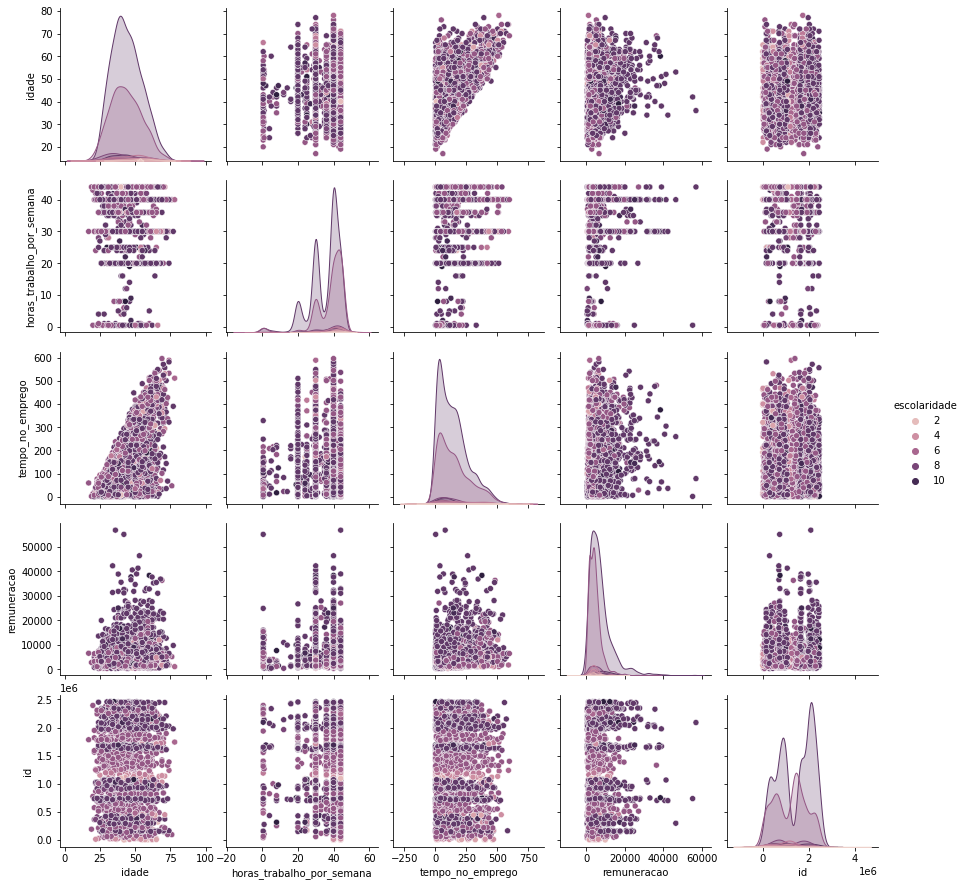

================portador_de_deficiencia=============


,portador_de_deficiencia,portador_de_deficiencia
0,3057,0.9935
1,20,0.0065


Grafico de distribuição de idade com relação a portador_de_deficiencia


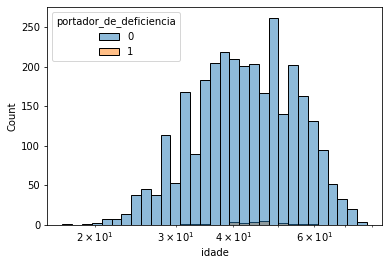

==================Categoria 0


count    3057.000000
mean       43.859012
std        10.861248
min        17.000000
25%        36.000000
50%        43.000000
75%        52.000000
max        78.000000
Name: idade, dtype: float64

==================Categoria 1


count    20.000000
mean     45.000000
std       7.405546
min      32.000000
25%      40.000000
50%      45.000000
75%      48.000000
max      60.000000
Name: idade, dtype: float64

Grafico de distribuição de horas_trabalho_por_semana com relação a portador_de_deficiencia


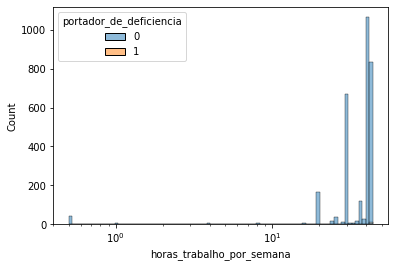

==================Categoria 0


count    3057.000000
mean       36.351652
std         8.584285
min         0.500000
25%        30.000000
50%        40.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 1


count    20.000000
mean     38.400000
std       6.644349
min      24.000000
25%      35.750000
50%      41.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a portador_de_deficiencia


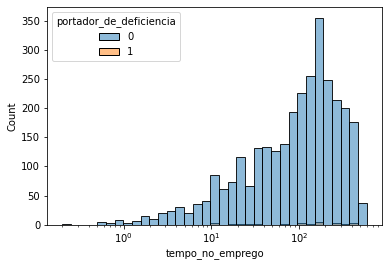

==================Categoria 0


count    3057.000000
mean      144.772522
std       124.272541
min         0.200000
25%        39.300000
50%       115.200000
75%       212.100000
max       596.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 1


count     20.000000
mean     151.595000
std      131.176267
min        9.800000
25%       32.950000
50%      133.600000
75%      197.125000
max      456.800000
Name: tempo_no_emprego, dtype: float64

Grafico de distribuição de remuneracao com relação a portador_de_deficiencia


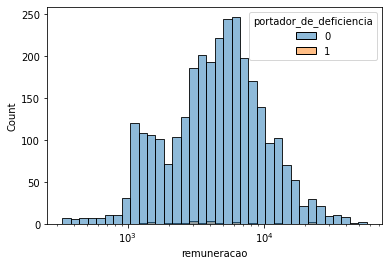

==================Categoria 0


count     3057.000000
mean      6063.987242
std       5490.862423
min        330.730000
25%       2649.650000
50%       4695.990000
75%       7563.900000
max      56849.230000
Name: remuneracao, dtype: float64

==================Categoria 1


count       20.000000
mean      5777.899000
std       5884.549525
min       1318.580000
25%       2578.350000
50%       3661.425000
75%       6053.982500
max      21293.160000
Name: remuneracao, dtype: float64

Grafico de distribuição de id com relação a portador_de_deficiencia


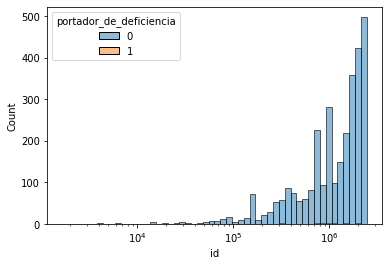

==================Categoria 0


count    3.057000e+03
mean     1.311968e+06
std      7.201783e+05
min      1.671000e+03
25%      7.128930e+05
50%      1.361017e+06
75%      2.014420e+06
max      2.459844e+06
Name: id, dtype: float64

==================Categoria 1


count    2.000000e+01
mean     1.098808e+06
std      6.467016e+05
min      5.513700e+04
25%      7.056152e+05
50%      1.003396e+06
75%      1.511548e+06
max      2.458375e+06
Name: id, dtype: float64

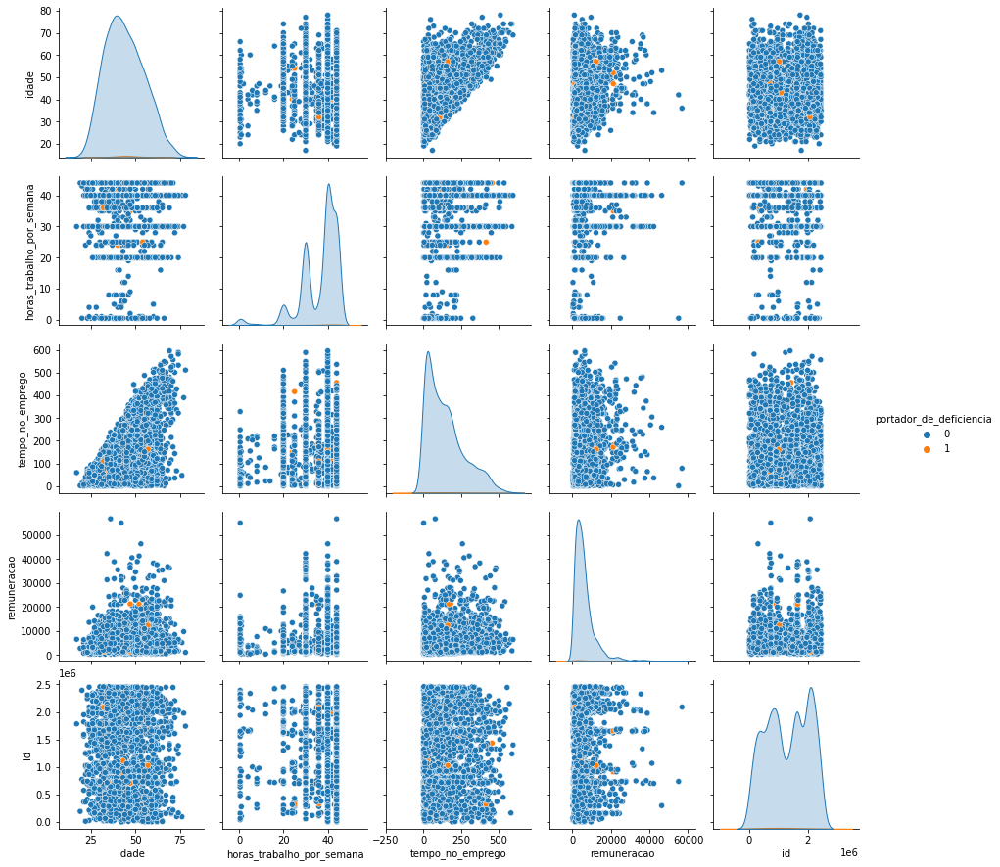

================tamanho_da_empresa=============


,tamanho_da_empresa,tamanho_da_empresa
10,1610,0.523237
9,398,0.129347
7,266,0.086448
8,261,0.084823
5,186,0.060448
6,150,0.048749
4,103,0.033474
3,64,0.020799
2,39,0.012675


Grafico de distribuição de idade com relação a tamanho_da_empresa


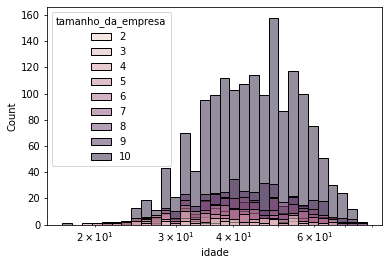

==================Categoria 7


count    266.000000
mean      42.721805
std       10.760763
min       21.000000
25%       34.000000
50%       42.000000
75%       51.000000
max       77.000000
Name: idade, dtype: float64

==================Categoria 4


count    103.000000
mean      38.621359
std       10.967972
min       19.000000
25%       29.500000
50%       37.000000
75%       45.500000
max       67.000000
Name: idade, dtype: float64

==================Categoria 10


count    1610.000000
mean       45.260248
std        10.597969
min        17.000000
25%        37.000000
50%        45.000000
75%        53.000000
max        78.000000
Name: idade, dtype: float64

==================Categoria 8


count    261.000000
mean      43.547893
std       10.470958
min       22.000000
25%       36.000000
50%       42.000000
75%       51.000000
max       74.000000
Name: idade, dtype: float64

==================Categoria 6


count    150.000000
mean      43.040000
std       11.503066
min       22.000000
25%       34.000000
50%       41.000000
75%       50.750000
max       72.000000
Name: idade, dtype: float64

==================Categoria 9


count    398.000000
mean      43.550251
std       10.699525
min       21.000000
25%       35.000000
50%       42.000000
75%       50.000000
max       71.000000
Name: idade, dtype: float64

==================Categoria 3


count    64.000000
mean     41.046875
std      11.498005
min      22.000000
25%      32.000000
50%      40.000000
75%      49.250000
max      65.000000
Name: idade, dtype: float64

==================Categoria 5


count    186.000000
mean      39.564516
std       10.829321
min       20.000000
25%       32.000000
50%       38.000000
75%       45.000000
max       70.000000
Name: idade, dtype: float64

==================Categoria 2


count    39.000000
mean     41.666667
std       9.715244
min      26.000000
25%      35.000000
50%      40.000000
75%      49.500000
max      63.000000
Name: idade, dtype: float64

Grafico de distribuição de horas_trabalho_por_semana com relação a tamanho_da_empresa


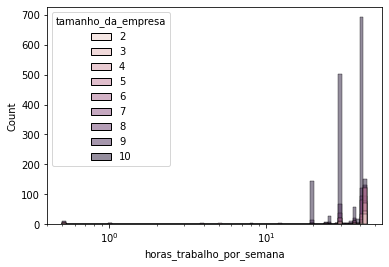

==================Categoria 7


count    266.000000
mean      38.067669
std        9.991087
min        0.500000
25%       40.000000
50%       40.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 4


count    103.000000
mean      40.150485
std        8.893938
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 10


count    1610.000000
mean       34.815839
std         7.142740
min         0.500000
25%        30.000000
50%        40.000000
75%        40.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 8


count    261.000000
mean      38.231801
std        7.918752
min        0.500000
25%       36.000000
50%       40.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 6


count    150.000000
mean      37.143333
std       11.094520
min        0.500000
25%       35.250000
50%       43.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 9


count    398.000000
mean      36.428392
std        9.579471
min        0.500000
25%       30.000000
50%       40.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 3


count    64.000000
mean     39.601562
std       9.797627
min       0.500000
25%      40.000000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 5


count    186.000000
mean      39.454301
std       10.263386
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 2


count    39.000000
mean     42.525641
std       6.995251
min       0.500000
25%      44.000000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a tamanho_da_empresa


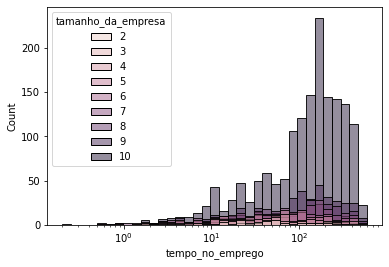

==================Categoria 7


count    266.000000
mean     114.277444
std      113.065333
min        0.500000
25%       23.000000
50%       74.050000
75%      166.575000
max      545.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 4


count    103.000000
mean      87.084466
std      104.672862
min        0.900000
25%       18.100000
50%       46.900000
75%      113.600000
max      414.300000
Name: tempo_no_emprego, dtype: float64

==================Categoria 10


count    1610.000000
mean      168.076273
std       125.760885
min         0.900000
25%        65.900000
50%       149.850000
75%       245.850000
max       596.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 8


count    261.000000
mean     139.130651
std      123.963437
min        0.500000
25%       36.500000
50%      112.400000
75%      202.900000
max      581.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 6


count    150.000000
mean     111.403333
std      105.643688
min        0.900000
25%       36.075000
50%       80.650000
75%      151.900000
max      507.300000
Name: tempo_no_emprego, dtype: float64

==================Categoria 9


count    398.000000
mean     144.935678
std      126.669700
min        0.200000
25%       34.975000
50%      111.700000
75%      212.675000
max      549.400000
Name: tempo_no_emprego, dtype: float64

==================Categoria 3


count     64.000000
mean      78.134375
std       91.619320
min        0.700000
25%       14.875000
50%       50.400000
75%       97.650000
max      460.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 5


count    186.000000
mean      91.605376
std      107.511447
min        0.500000
25%       18.150000
50%       58.150000
75%      113.725000
max      536.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 2


count     39.000000
mean      73.948718
std       77.788779
min        4.600000
25%       22.450000
50%       46.900000
75%      102.400000
max      342.900000
Name: tempo_no_emprego, dtype: float64

Grafico de distribuição de remuneracao com relação a tamanho_da_empresa


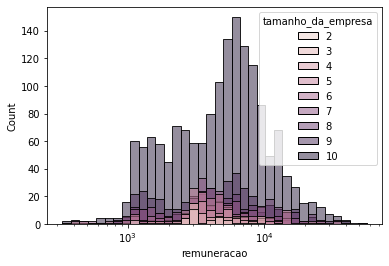

==================Categoria 7


count      266.000000
mean      5254.596692
std       4683.137807
min        369.780000
25%       2423.557500
50%       3977.480000
75%       6427.675000
max      38359.080000
Name: remuneracao, dtype: float64

==================Categoria 4


count      103.000000
mean      5568.206019
std       5310.217281
min        342.950000
25%       3076.635000
50%       3961.230000
75%       5938.350000
max      38947.500000
Name: remuneracao, dtype: float64

==================Categoria 10


count     1610.000000
mean      6354.955789
std       5428.233314
min        331.300000
25%       2570.572500
50%       5302.815000
75%       7996.125000
max      46377.980000
Name: remuneracao, dtype: float64

==================Categoria 8


count      261.000000
mean      6963.745364
std       6628.040146
min        433.760000
25%       2929.950000
50%       5132.230000
75%       9361.480000
max      56849.230000
Name: remuneracao, dtype: float64

==================Categoria 6


count      150.000000
mean      5348.909267
std       4979.579460
min        330.730000
25%       2933.845000
50%       3951.415000
75%       5720.550000
max      31046.630000
Name: remuneracao, dtype: float64

==================Categoria 9


count      398.000000
mean      6042.761080
std       6275.924449
min        458.990000
25%       2005.172500
50%       4457.360000
75%       7291.812500
max      55122.470000
Name: remuneracao, dtype: float64

==================Categoria 3


count       64.000000
mean      4903.335937
std       3151.311266
min       1378.040000
25%       3044.250000
50%       3904.990000
75%       5792.367500
max      22445.450000
Name: remuneracao, dtype: float64

==================Categoria 5


count      186.000000
mean      5162.557258
std       4678.226633
min        350.840000
25%       2907.267500
50%       3837.230000
75%       5374.080000
max      32972.390000
Name: remuneracao, dtype: float64

==================Categoria 2


count       39.000000
mean      3884.570000
std       2425.640659
min        375.510000
25%       2783.770000
50%       3210.520000
75%       4828.045000
max      13012.240000
Name: remuneracao, dtype: float64

Grafico de distribuição de id com relação a tamanho_da_empresa


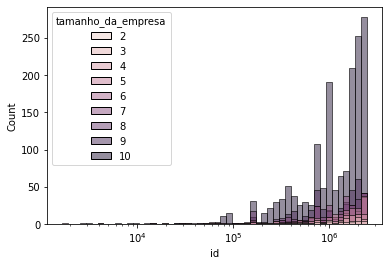

==================Categoria 7


count    2.660000e+02
mean     1.265485e+06
std      6.899749e+05
min      1.981500e+04
25%      7.305090e+05
50%      1.262708e+06
75%      1.697406e+06
max      2.458009e+06
Name: id, dtype: float64

==================Categoria 4


count    1.030000e+02
mean     1.216783e+06
std      7.525254e+05
min      4.272000e+03
25%      5.374195e+05
50%      1.378031e+06
75%      1.885182e+06
max      2.440796e+06
Name: id, dtype: float64

==================Categoria 10


count    1.610000e+03
mean     1.344044e+06
std      7.189656e+05
min      2.947000e+03
25%      7.246808e+05
50%      1.448932e+06
75%      2.030326e+06
max      2.459844e+06
Name: id, dtype: float64

==================Categoria 8


count    2.610000e+02
mean     1.283921e+06
std      7.293830e+05
min      1.278000e+04
25%      6.968970e+05
50%      1.386109e+06
75%      2.015771e+06
max      2.456726e+06
Name: id, dtype: float64

==================Categoria 6


count    1.500000e+02
mean     1.375186e+06
std      7.379732e+05
min      1.671000e+03
25%      7.320585e+05
50%      1.408190e+06
75%      2.084738e+06
max      2.451607e+06
Name: id, dtype: float64

==================Categoria 9


count    3.980000e+02
mean     1.223734e+06
std      7.061422e+05
min      2.640000e+03
25%      6.651462e+05
50%      1.217586e+06
75%      1.875522e+06
max      2.445609e+06
Name: id, dtype: float64

==================Categoria 3


count    6.400000e+01
mean     1.222010e+06
std      7.298724e+05
min      2.029000e+04
25%      6.120202e+05
50%      1.279054e+06
75%      1.952434e+06
max      2.394393e+06
Name: id, dtype: float64

==================Categoria 5


count    1.860000e+02
mean     1.358818e+06
std      7.463992e+05
min      1.484800e+04
25%      7.091432e+05
50%      1.520632e+06
75%      2.029292e+06
max      2.457951e+06
Name: id, dtype: float64

==================Categoria 2


count    3.900000e+01
mean     1.216124e+06
std      6.455643e+05
min      2.487130e+05
25%      6.742625e+05
50%      1.028482e+06
75%      1.711349e+06
max      2.337113e+06
Name: id, dtype: float64

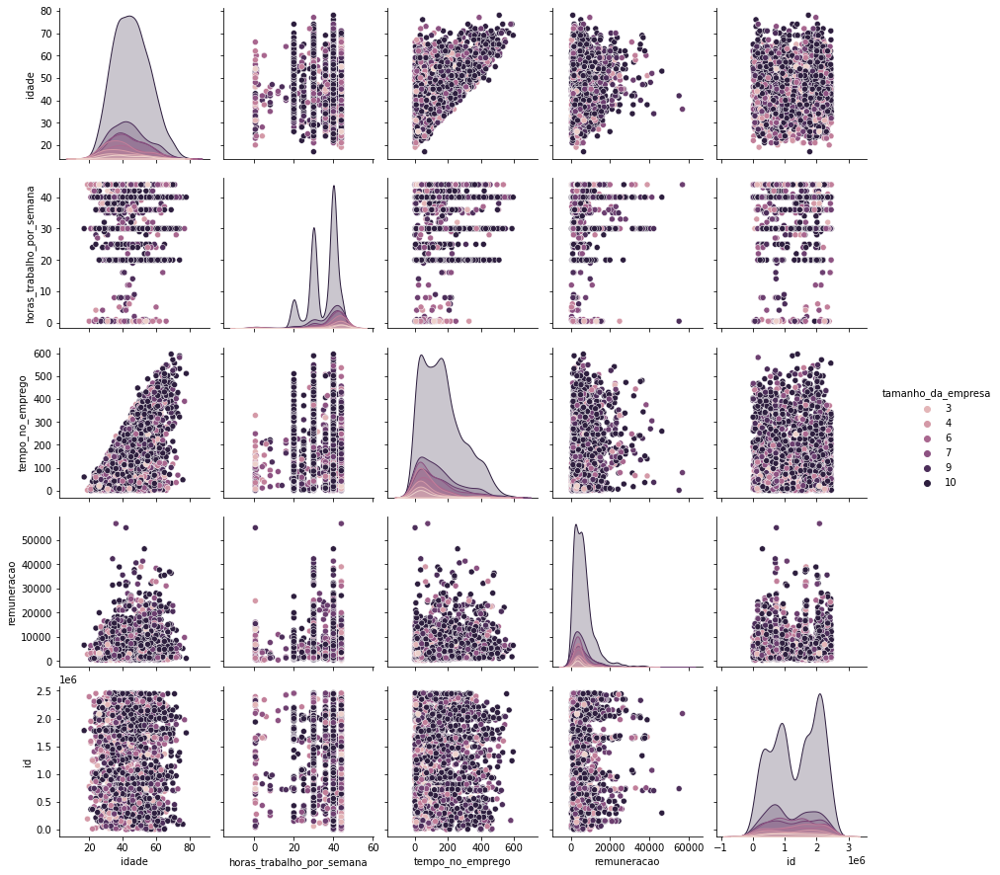

In [ ]:
def tira_0(x):
  if x == 0:
    return 0.5
  else:
    return x
cat = ['sexo', 'faixa_etaria', 'cor_raca', 'escolaridade', 'portador_de_deficiencia', 'tamanho_da_empresa']
num = out.drop(cat, axis = 1).columns.copy()
palette=sns.color_palette("Paired")
dad = out.copy()
for i in cat:
  p = num.to_list().copy()
  print(f'================{i}=============')
  display(pd.concat([out[i].value_counts(), out[i].value_counts(normalize = True)], axis = 1))
  for j in num:
    if 0 in dad[j].unique():
      dad[j] = dad[j].apply(tira_0)
    else:
      pass
    print(f'Grafico de distribuição de {j} com relação a {i}')
    fig = px.histogram(out, x = j, color = i)
    fig.show()
    dad[dad[j]==0][j] = 10
    sns.histplot(data = dad, x = j, hue = i, log_scale = True, )
    sns.histplot(palette=palette)
    plt.show()
    for k in dad[i].unique():
      print(f'==================Categoria {k}')
      filt = dad[dad[i]==k].copy()
      display(filt[j].describe())

  p.append(i)
  sns.pairplot(data = dad[p], hue = i)
  plt.show()
  